<a href="https://colab.research.google.com/github/Ocanthom/Data-Visiualization/blob/main/MACHINE_LEARNING_FINAL_PROJECT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

MACHINE LEARNING

*   FINAL PROJECT
*   ISAIAH THOMPSON OCANSEY



<h1 align="left"><font size="4">OBJECTIVE</font></h1>

The aim of this project is to analyze a data set obtained from a weight lifting exercise program, which involved six participants performing five different lifting techniques (A, B, C, D, and E) correctly and incorrectly, as indicated by the classe variable. Accelerometer data was collected from the belt, forearm, arm, and dumbbell of each participant.

The primary goal is to apply machine learning algorithms to predict the classe variable, which makes this a multi-class classification problem.

## LOADING PACKAGES
**Lets first load required libraries:**

In [ ]:
import itertools
import matplotlib.pyplot as plt
from matplotlib.ticker import NullFormatter
import pandas as pd
import numpy as np
import matplotlib.ticker as ticker
from sklearn import preprocessing
%matplotlib inline

from sklearn import metrics
from sklearn import datasets
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn import tree
from sklearn.model_selection import KFold, cross_val_score
from sklearn.model_selection import train_test_split

In [ ]:
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import train_test_split,cross_val_score,KFold,GridSearchCV
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score
import scikitplot as skplt

import math
import os
import sklearn
from datetime import datetime
import calendar
pd.set_option('display.max_rows', 1000)

In [ ]:
import warnings
warnings.filterwarnings('ignore')
plt.style.use('fivethirtyeight')
import plotly.express as px
from datetime import datetime
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

from sklearn.svm import SVC
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_auc_score
from numpy import mean
from sklearn.model_selection import train_test_split

# selection of algorithms to consider and set performance measure
from sklearn.linear_model import LogisticRegression, RidgeClassifier, SGDClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold, RandomizedSearchCV, GridSearchCV, ShuffleSplit, KFold, cross_validate


In [ ]:
from scipy.sparse import *
from sklearn.metrics.pairwise import pairwise_distances
from sklearn import preprocessing
from imblearn.over_sampling import SMOTE # pip install -U imbalanced-learn

# evaluation
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score

# classifiers
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn import svm
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier

import random

random.seed(48)

## DATA IMPORTATION

In [ ]:
train = pd.read_csv("WtLift.csv")

test = pd.read_csv("test.csv")

In [ ]:
print(f"The train data has {train.shape[0]} observations and {train.shape[1]} columns.")

print(f"The test set has {test.shape[0]} observations and {test.shape[1]} columns.")

The train data has 19442 observations and 160 columns.
The test set has 180 observations and 159 columns.


In [ ]:
train.head()

,obs,user_name,raw_timestamp_part_1,raw_timestamp_part_2,cvtd_timestamp,new_window,num_window,roll_belt,pitch_belt,yaw_belt,total_accel_belt,kurtosis_roll_belt,kurtosis_picth_belt,kurtosis_yaw_belt,skewness_roll_belt,skewness_roll_belt.1,skewness_yaw_belt,max_roll_belt,max_picth_belt,max_yaw_belt,min_roll_belt,min_pitch_belt,min_yaw_belt,amplitude_roll_belt,amplitude_pitch_belt,amplitude_yaw_belt,var_total_accel_belt,avg_roll_belt,stddev_roll_belt,var_roll_belt,avg_pitch_belt,stddev_pitch_belt,var_pitch_belt,avg_yaw_belt,stddev_yaw_belt,var_yaw_belt,gyros_belt_x,gyros_belt_y,gyros_belt_z,accel_belt_x,accel_belt_y,accel_belt_z,magnet_belt_x,magnet_belt_y,magnet_belt_z,roll_arm,pitch_arm,yaw_arm,total_accel_arm,var_accel_arm,avg_roll_arm,stddev_roll_arm,var_roll_arm,avg_pitch_arm,stddev_pitch_arm,var_pitch_arm,avg_yaw_arm,stddev_yaw_arm,var_yaw_arm,gyros_arm_x,gyros_arm_y,gyros_arm_z,accel_arm_x,accel_arm_y,accel_arm_z,magnet_arm_x,magnet_arm_y,magnet_arm_z,kurtosis_roll_arm,kurtosis_picth_arm,kurtosis_yaw_arm,skewness_roll_arm,skewness_pitch_arm,skewness_yaw_arm,max_roll_arm,max_picth_arm,max_yaw_arm,min_roll_arm,min_pitch_arm,min_yaw_arm,amplitude_roll_arm,amplitude_pitch_arm,amplitude_yaw_arm,roll_dumbbell,pitch_dumbbell,yaw_dumbbell,kurtosis_roll_dumbbell,kurtosis_picth_dumbbell,kurtosis_yaw_dumbbell,skewness_roll_dumbbell,skewness_pitch_dumbbell,skewness_yaw_dumbbell,max_roll_dumbbell,max_picth_dumbbell,max_yaw_dumbbell,min_roll_dumbbell,min_pitch_dumbbell,min_yaw_dumbbell,amplitude_roll_dumbbell,amplitude_pitch_dumbbell,amplitude_yaw_dumbbell,total_accel_dumbbell,var_accel_dumbbell,avg_roll_dumbbell,stddev_roll_dumbbell,var_roll_dumbbell,avg_pitch_dumbbell,stddev_pitch_dumbbell,var_pitch_dumbbell,avg_yaw_dumbbell,stddev_yaw_dumbbell,var_yaw_dumbbell,gyros_dumbbell_x,gyros_dumbbell_y,gyros_dumbbell_z,accel_dumbbell_x,accel_dumbbell_y,accel_dumbbell_z,magnet_dumbbell_x,magnet_dumbbell_y,magnet_dumbbell_z,roll_forearm,pitch_forearm,yaw_forearm,kurtosis_roll_forearm,kurtosis_picth_forearm,kurtosis_yaw_forearm,skewness_roll_forearm,skewness_pitch_forearm,skewness_yaw_forearm,max_roll_forearm,max_picth_forearm,max_yaw_forearm,min_roll_forearm,min_pitch_forearm,min_yaw_forearm,amplitude_roll_forearm,amplitude_pitch_forearm,amplitude_yaw_forearm,total_accel_forearm,var_accel_forearm,avg_roll_forearm,stddev_roll_forearm,var_roll_forearm,avg_pitch_forearm,stddev_pitch_forearm,var_pitch_forearm,avg_yaw_forearm,stddev_yaw_forearm,var_yaw_forearm,gyros_forearm_x,gyros_forearm_y,gyros_forearm_z,accel_forearm_x,accel_forearm_y,accel_forearm_z,magnet_forearm_x,magnet_forearm_y,magnet_forearm_z,classe
0,1,carlitos,1323084231,788290,05/12/2011 11:23,no,11,1.41,8.07,-94.4,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,-0.02,-21,4,22,-3,599,-313,-128.0,22.5,-161.0,34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,-0.02,-288,109,-123,-368,337,516,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.052175,-70.494004,-84.873939,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,37,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,-0.02,0.00,-234,47,-271,-559,293,-65.0,28.4,-63.9,-153.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,36,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.03,0.00,-0.02,192,203,-215,-17,654.0,476.0,A
1,2,carlitos,1323084231,808298,05/12/2011 11:23,no,11,1.41,8.07,-94.4,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.02,0.00,-0.02,-22,4,22,-7,608,-311,-128.0,22.5,-161.0,34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.02,-0.02,-0.02,-290,110,-125,-369,337,513,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.130740,-70.637505,-84.710647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,37,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,-0.02,0.00,-233,47,-269,-555,296,-64.0,28.3,-63.9,-153.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,36,NaN,NaN,Na

### Checking for the columns of the data and missing values

In [ ]:
print(train.isna().sum())

obs                             0
user_name                       0
raw_timestamp_part_1            0
raw_timestamp_part_2            0
cvtd_timestamp                  0
new_window                      0
num_window                      0
roll_belt                       0
pitch_belt                      0
yaw_belt                        0
total_accel_belt                0
kurtosis_roll_belt          19049
kurtosis_picth_belt         19070
kurtosis_yaw_belt           19442
skewness_roll_belt          19048
skewness_roll_belt.1        19070
skewness_yaw_belt           19442
max_roll_belt               19039
max_picth_belt              19039
max_yaw_belt                19049
min_roll_belt               19039
min_pitch_belt              19039
min_yaw_belt                19049
amplitude_roll_belt         19039
amplitude_pitch_belt        19039
amplitude_yaw_belt          19049
var_total_accel_belt        19039
avg_roll_belt               19039
stddev_roll_belt            19039
var_roll_belt 

### Comment:

- Performing some preliminary investigation of the data, it is observed that the training dataset comes with 19442 observations of 160 variables.
- The outcome of the given classification problem is given by the variable **classe** in the last column which is a factor variable with 5 levels “A”,“B”,“C”,“D”, and “E”.
- The outcome variable classe, however, is not included in the test dataset.
- Both datasets are consistent in their variable names (except for the last column with the outcome classe in the training dataset) and contain a considerable number of missing values marked as NA.

<Axes: >

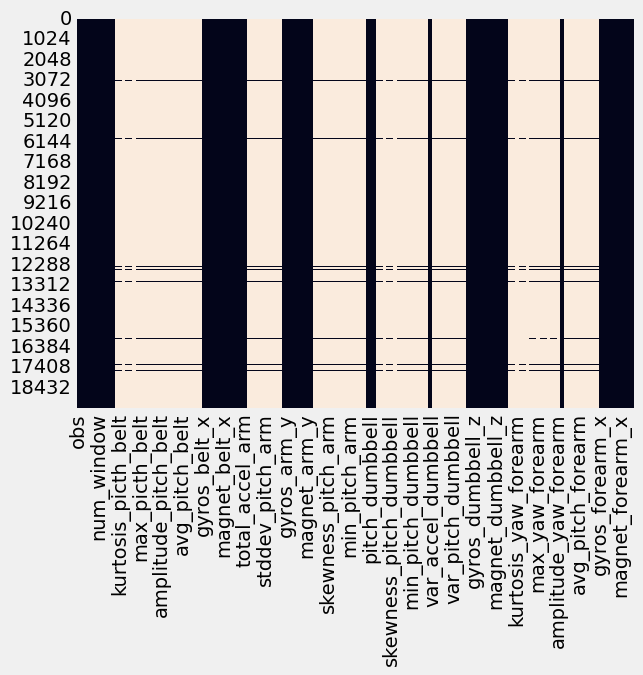

In [ ]:
sns.heatmap(train.isnull(), cbar=False) # Heatmap to visualise NAs

#### Comment:

It can be seen that the dataset obviously has a lot of missing data in some of the columns. Where this data is provided is probably specific to a particular workout kind or class.
Imputation is ineffective because of the amount of the missing values. In other columns, there are no missing values.

Under this circumstance, it could be appropriate to create a separate dataframe for the cases in which there are additional data.

In [ ]:
train.describe()

,obs,raw_timestamp_part_1,raw_timestamp_part_2,num_window,roll_belt,pitch_belt,yaw_belt,total_accel_belt,kurtosis_roll_belt,kurtosis_picth_belt,kurtosis_yaw_belt,skewness_roll_belt,skewness_roll_belt.1,skewness_yaw_belt,max_roll_belt,max_picth_belt,max_yaw_belt,min_roll_belt,min_pitch_belt,min_yaw_belt,amplitude_roll_belt,amplitude_pitch_belt,amplitude_yaw_belt,var_total_accel_belt,avg_roll_belt,stddev_roll_belt,var_roll_belt,avg_pitch_belt,stddev_pitch_belt,var_pitch_belt,avg_yaw_belt,stddev_yaw_belt,var_yaw_belt,gyros_belt_x,gyros_belt_y,gyros_belt_z,accel_belt_x,accel_belt_y,accel_belt_z,magnet_belt_x,magnet_belt_y,magnet_belt_z,roll_arm,pitch_arm,yaw_arm,total_accel_arm,var_accel_arm,avg_roll_arm,stddev_roll_arm,var_roll_arm,avg_pitch_arm,stddev_pitch_arm,var_pitch_arm,avg_yaw_arm,stddev_yaw_arm,var_yaw_arm,gyros_arm_x,gyros_arm_y,gyros_arm_z,accel_arm_x,accel_arm_y,accel_arm_z,magnet_arm_x,magnet_arm_y,magnet_arm_z,kurtosis_roll_arm,kurtosis_picth_arm,kurtosis_yaw_arm,skewness_roll_arm,skewness_pitch_arm,skewness_yaw_arm,max_roll_arm,max_picth_arm,max_yaw_arm,min_roll_arm,min_pitch_arm,min_yaw_arm,amplitude_roll_arm,amplitude_pitch_arm,amplitude_yaw_arm,roll_dumbbell,pitch_dumbbell,yaw_dumbbell,kurtosis_roll_dumbbell,kurtosis_picth_dumbbell,kurtosis_yaw_dumbbell,skewness_roll_dumbbell,skewness_pitch_dumbbell,skewness_yaw_dumbbell,max_roll_dumbbell,max_picth_dumbbell,max_yaw_dumbbell,min_roll_dumbbell,min_pitch_dumbbell,min_yaw_dumbbell,amplitude_roll_dumbbell,amplitude_pitch_dumbbell,amplitude_yaw_dumbbell,total_accel_dumbbell,var_accel_dumbbell,avg_roll_dumbbell,stddev_roll_dumbbell,var_roll_dumbbell,avg_pitch_dumbbell,stddev_pitch_dumbbell,var_pitch_dumbbell,avg_yaw_dumbbell,stddev_yaw_dumbbell,var_yaw_dumbbell,gyros_dumbbell_x,gyros_dumbbell_y,gyros_dumbbell_z,accel_dumbbell_x,accel_dumbbell_y,accel_dumbbell_z,magnet_dumbbell_x,magnet_dumbbell_y,magnet_dumbbell_z,roll_forearm,pitch_forearm,yaw_forearm,kurtosis_roll_forearm,kurtosis_picth_forearm,kurtosis_yaw_forearm,skewness_roll_forearm,skewness_pitch_forearm,skewness_yaw_forearm,max_roll_forearm,max_picth_forearm,max_yaw_forearm,min_roll_forearm,min_pitch_forearm,min_yaw_forearm,amplitude_roll_forearm,amplitude_pitch_forearm,amplitude_yaw_forearm,total_accel_forearm,var_accel_forearm,avg_roll_forearm,stddev_roll_forearm,var_roll_forearm,avg_pitch_forearm,stddev_pitch_forearm,var_pitch_forearm,avg_yaw_forearm,stddev_yaw_forearm,var_yaw_forearm,gyros_forearm_x,gyros_forearm_y,gyros_forearm_z,accel_forearm_x,accel_forearm_y,accel_forearm_z,magnet_forearm_x,magnet_forearm_y,magnet_forearm_z
count,19442.000000,1.944200e+04,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,393.000000,372.000000,0.0,394.000000,372.000000,0.0,403.000000,403.000000,393.000000,403.000000,403.000000,393.000000,403.000000,403.000000,393.0,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.00000,403.000000,403.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.00000,19442.000000,19442.000000,19442.000000,19442.00000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,325.000000,323.000000,392.000000,326.000000,323.000000,392.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,19442.000000,19442.000000,19442.000000,398.000000,401.000000,0.0,399.000000,402.000000,0.0,403.000000,403.000000,398.000000,403.000000,403.000000,398.000000,403.000000,403.000000,398.0,19442.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,403.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,19442.000000,320.000000,319.0000

## Exploratory Data Analysis


In order to start figuring out which variables are related to the target (**classe**), it makes sense to first run few pairplots using class as the Hue. This is something we can only do with training data. Examining the frequency of classes and participation will be our first step.

In [ ]:
train['classe']=train['classe'].astype('category')

In [ ]:
freq_plot1=train.filter(items=['user_name', 'classe'])
freq_plot1=freq_plot1.groupby(['user_name'])['classe'].agg(counts='value_counts').reset_index()


<Axes: xlabel='counts', ylabel='user_name'>

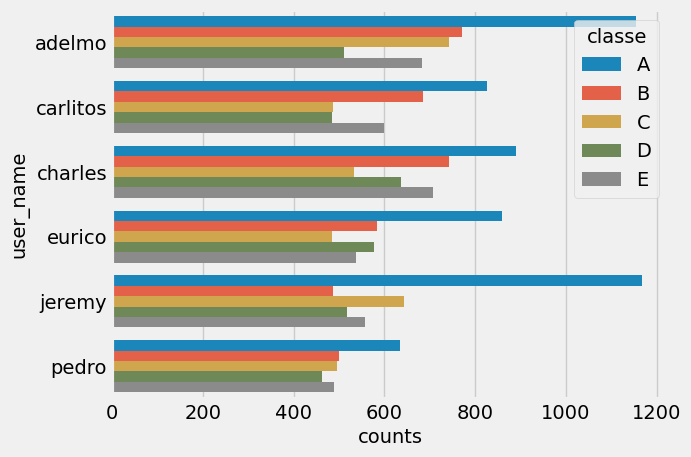

In [ ]:
sns.barplot(data = freq_plot1, x = 'counts', y = 'user_name', hue = 'classe', ci = None)

In [ ]:
# show % of samples per classe
def show_classes_distribution(y):
    n_samples = len(y)
    labels = np.unique(y)
    counts = pd.value_counts(y) / n_samples

    df = pd.DataFrame({'classe': labels, 'percent': counts})
    # counts.plot.bar(x='counts', y='classe', rot=0)
    ax = sns.barplot(x='classe', y="percent", data=df)

Unbalanced data


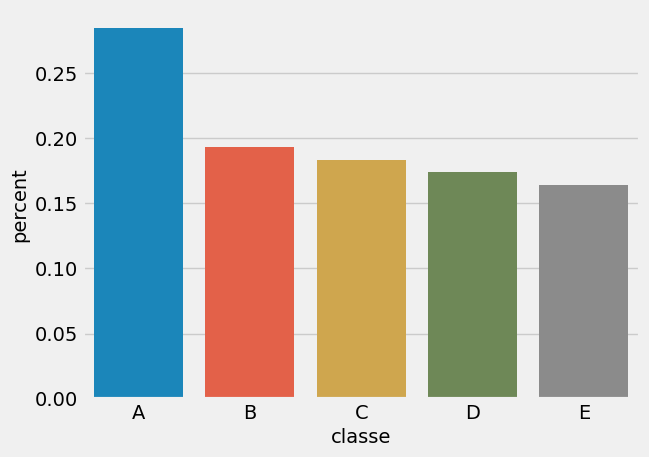

In [ ]:
y_train = train['classe']
print('Unbalanced data')
show_classes_distribution(y_train)


#### Comment:

The frequency of class A is obviously significantly higher than that of the other classes. The classes are not equally distributed among the users.  aren't distributed among the classes equitably.
In comparison to other classes, Jeremy, for instance, has around twice as many A's

This is important as "user" may be an important predictive variable when predicting the test data, and we will later need to One Hot Encode user.

#### PAIRPLOTS

To better understand the distribution of the variables, the pairplot was used.
- First, is the pairplots of the **num_window, roll_belt, pitch_belt, yaw_belt and total_accel_belt**

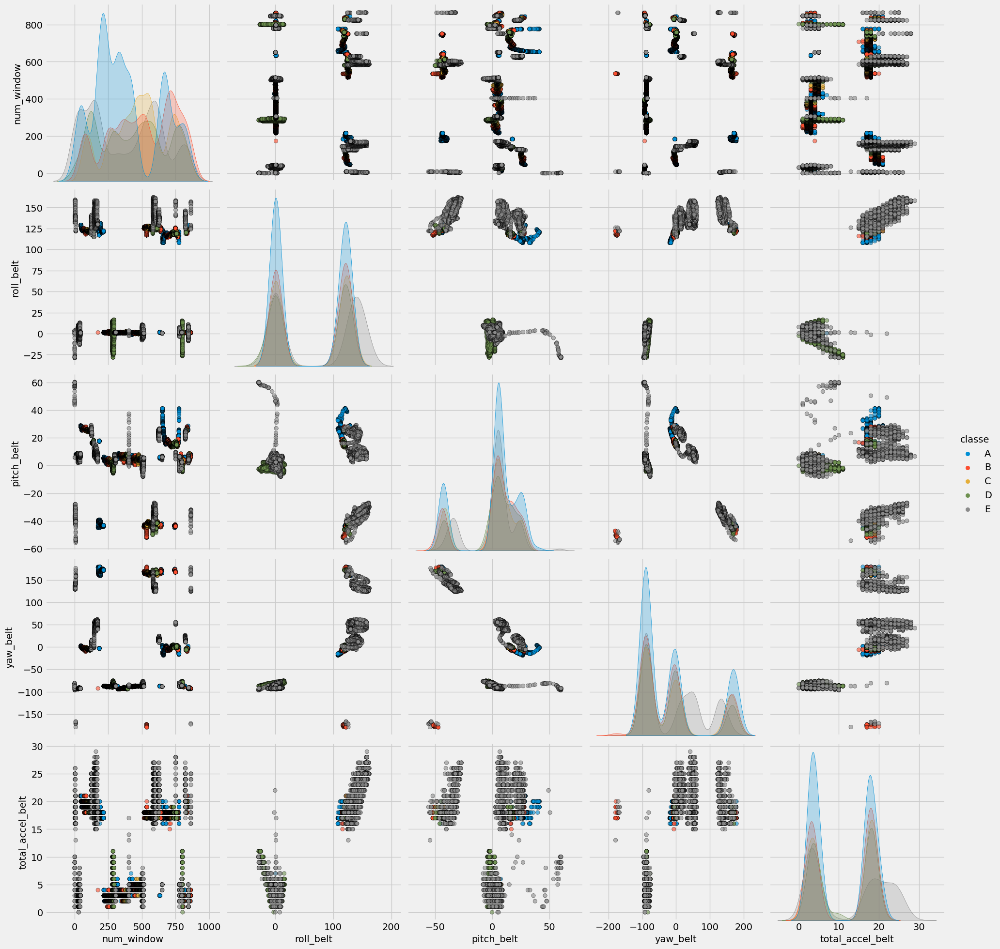

In [ ]:
pairplot1=train.filter(items=['num_window', 'roll_belt', 'pitch_belt', 'yaw_belt', 'total_accel_belt', 'classe'])
sns.pairplot(pairplot1, hue='classe',  plot_kws = {'alpha': 0.6, 'edgecolor': 'k'},size = 4)

#### Comment:

From the plot above, it can be seen that, there aren't any large differences in these relationships regarding class. However, the distribution does seem to be slightly different across different classes.

Next, we look at the **X and Y** axes of the gyros, accel and magnet belt.

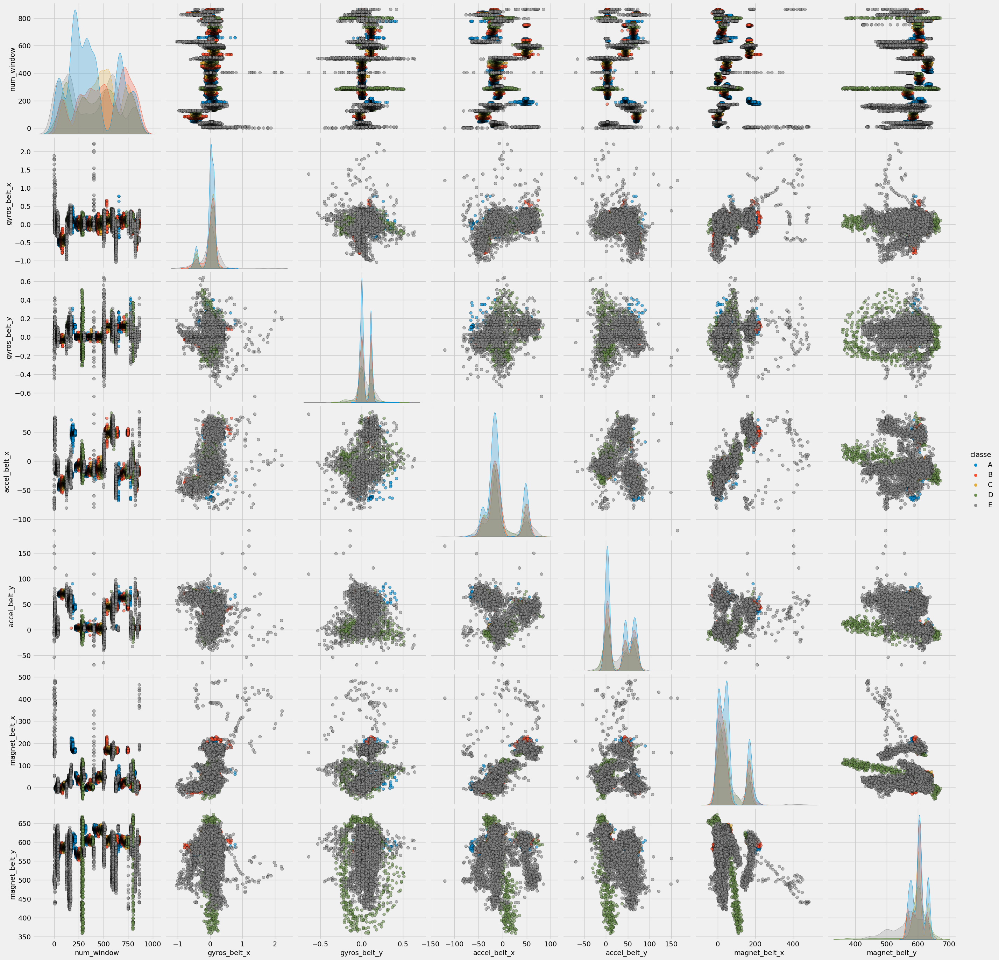

In [ ]:
pairplot2=train.filter(items=['num_window', 'gyros_belt_x', 'gyros_belt_y', 'accel_belt_x', 'accel_belt_y',  'magnet_belt_x','magnet_belt_y', 'classe'])
sns.pairplot(pairplot2, hue='classe',  plot_kws = {'alpha': 0.6,  'edgecolor': 'k'},size = 4)

#### Comment:
- Again it can be observed that, the data is closely grouped.
- We can see that movement **class D** has some determinable features not shared by the others on these axes (x and y axes).


**Can the Z-axes provide any more information?**

In order to examine whether the z-axis can provide more information, we look at the Z axes of the gyros, accel and magnet belt.

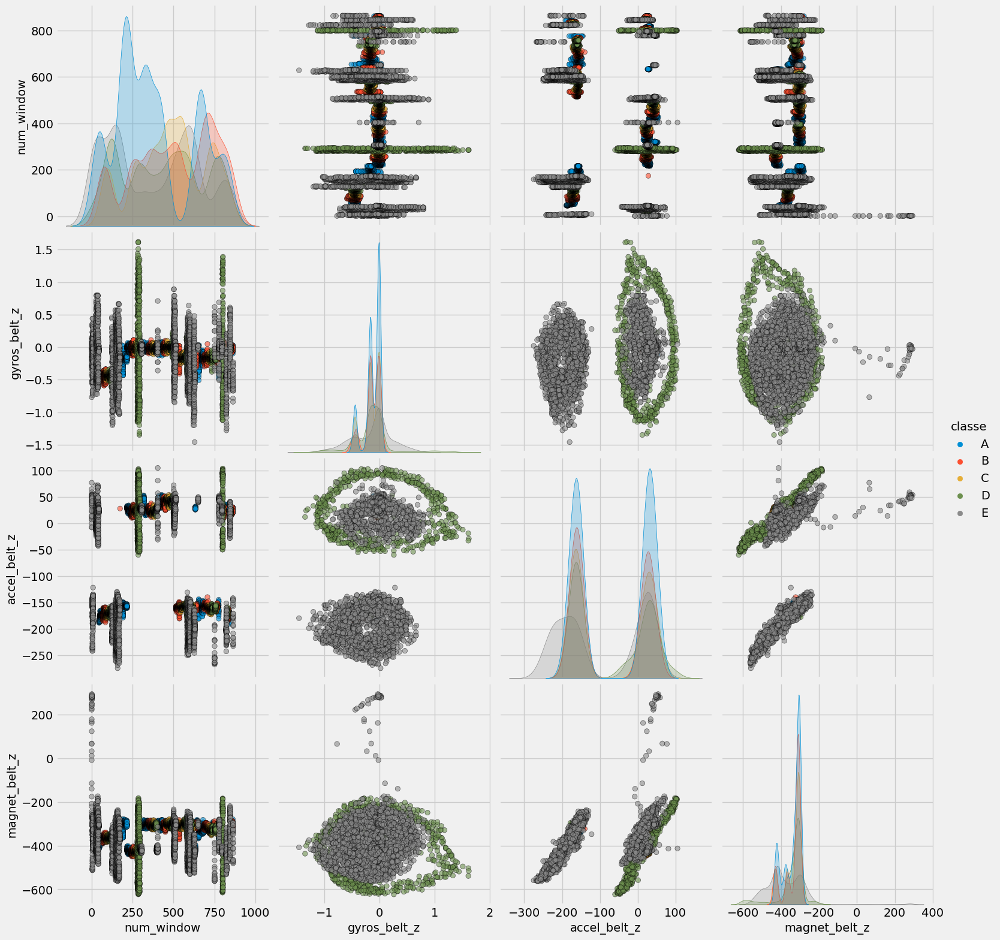

In [ ]:
pairplot3=train.filter(items=['num_window', 'gyros_belt_z', 'accel_belt_z', 'magnet_belt_z', 'classe'])
sns.pairplot(pairplot3, hue='classe',  plot_kws = {'alpha': 0.6, 'edgecolor': 'k'},size = 4)

#### Comment:
Now we see some extremely distinctive features of class D on the Z axis. This means these variables will be important in classification.

Next we consider the pairplots of roll_arm', 'pitch_arm', 'yaw_arm', 'total_accel_arm'

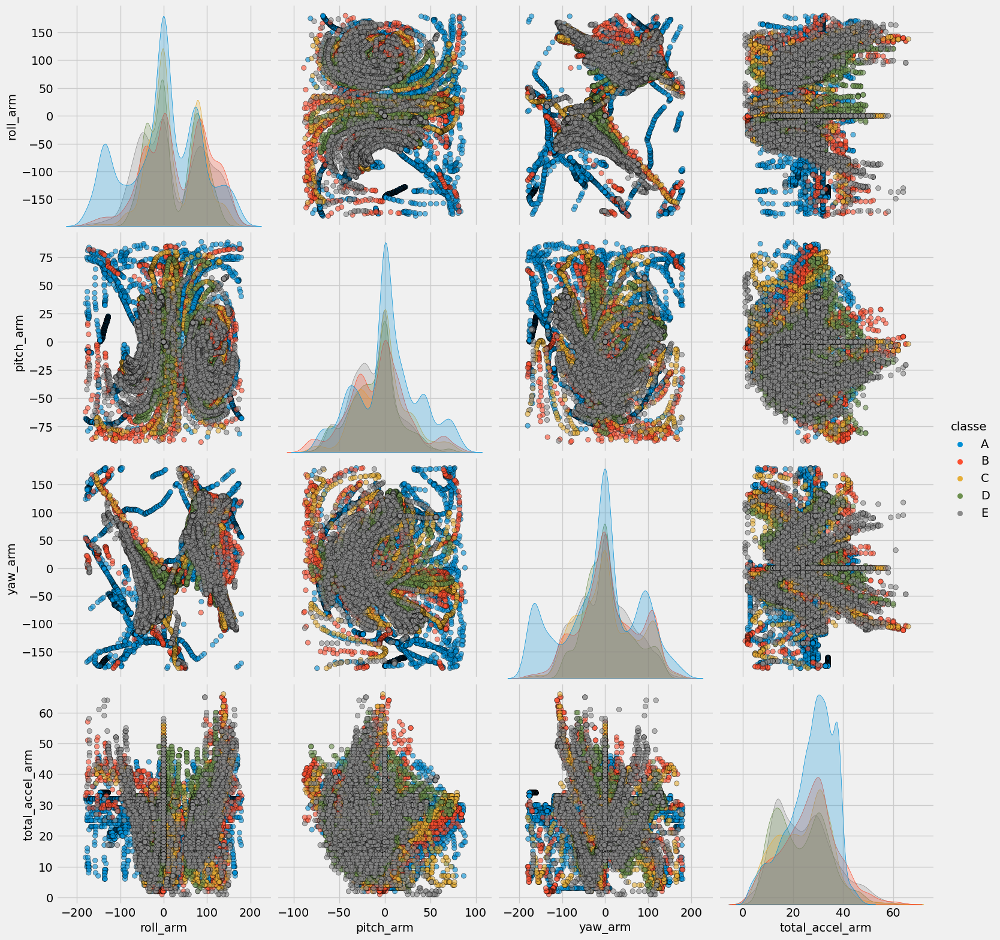

In [ ]:
pairplot4=train.filter(items=['roll_arm', 'pitch_arm', 'yaw_arm', 'total_accel_arm', 'classe'])
sns.pairplot(pairplot4, hue='classe',  plot_kws = {'alpha': 0.6, 'edgecolor': 'k'},size = 4)

#### COmment:

- The arm data shows significantly different patterns from the belt data.
- However, there is not a considerable difference between classes.


**Again, lets look at them on the x/y and then the Z axis**

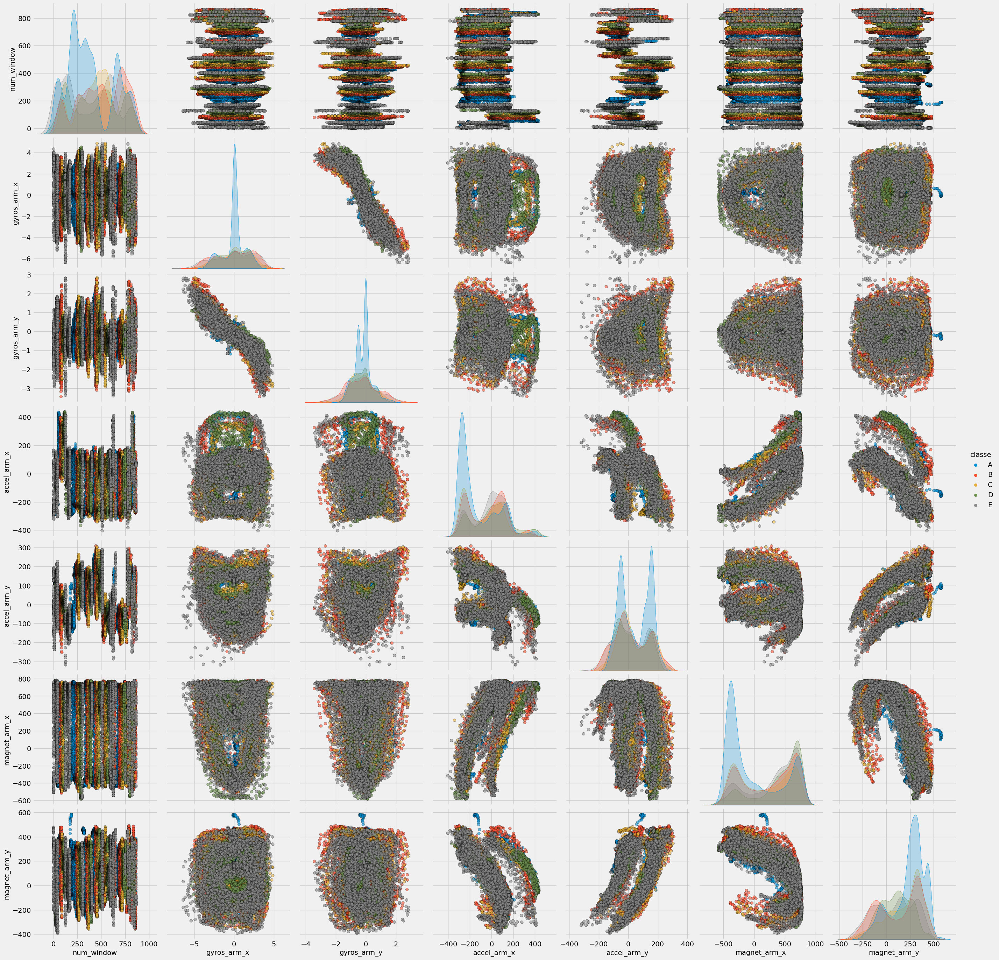

In [ ]:
pairplot5=train.filter(items=['num_window', 'gyros_arm_x', 'gyros_arm_y', 'accel_arm_x', 'accel_arm_y',  'magnet_arm_x','magnet_arm_y', 'classe'])
sns.pairplot(pairplot5, hue='classe',  plot_kws = {'alpha': 0.6,  'edgecolor': 'k'},size = 4)

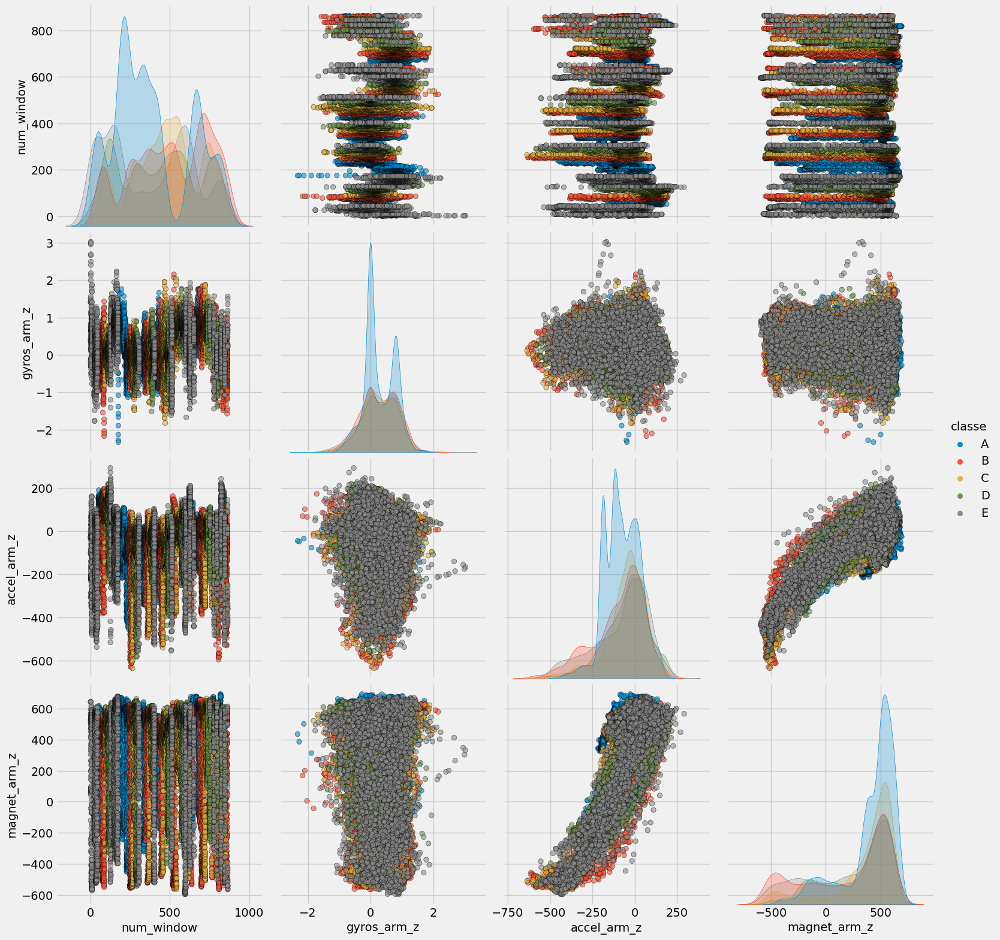

In [ ]:
pairplot6=train.filter(items=['num_window', 'gyros_arm_z', 'accel_arm_z', 'magnet_arm_z', 'classe'])
sns.pairplot(pairplot6, hue='classe',  plot_kws = {'alpha': 0.6, 'edgecolor': 'k'},size = 4)

#### Comment:

The differences here are again subtle. The distribution of A seems to take a distinctly different pattern from the others.


#### Remark:

We can do similar plots for the forearm variables if we wanted but i'll skip it for now. Lastly, lets take a look at some of the
Variables where nearly all data is missing. If this is uninformative, it makes sense for us to remove it, however it may give
away a certain class clearly. Since there are many of these I shall just pick a few out.

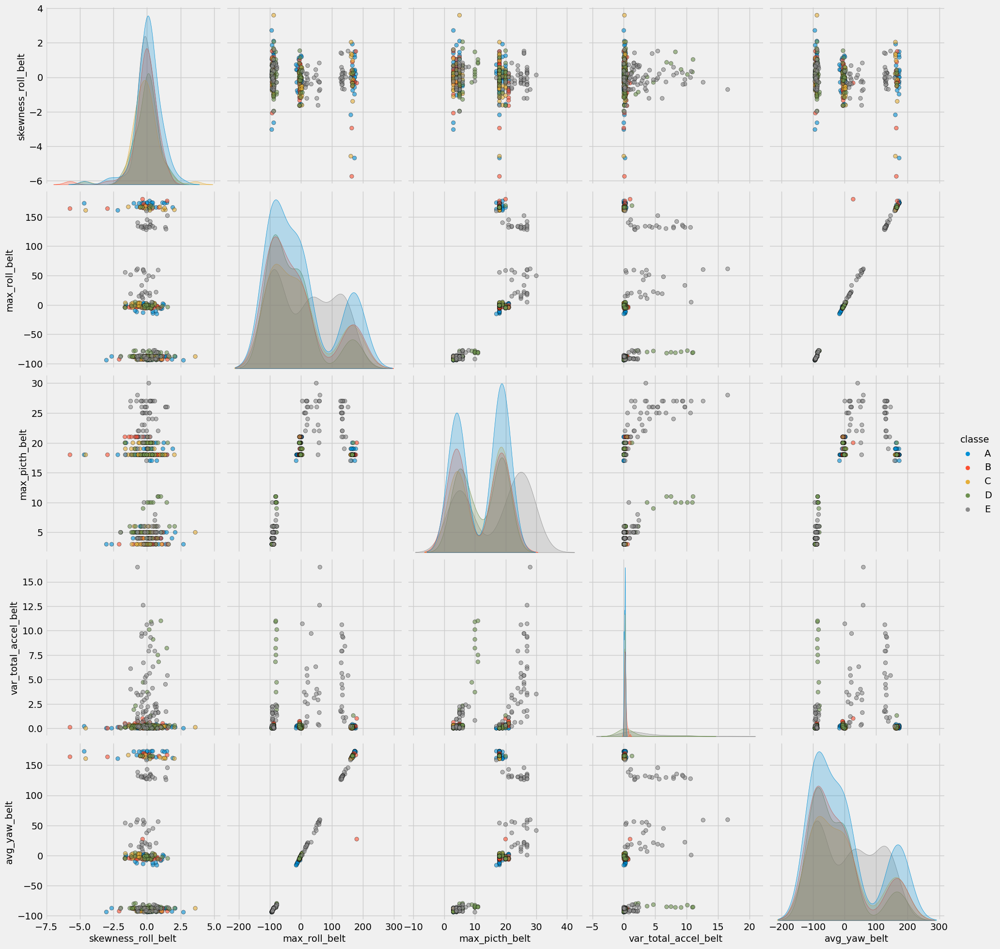

In [ ]:
pairplot7=train.filter(items=['skewness_roll_belt', 'max_roll_belt', 'max_picth_belt',
                                 'var_total_accel_belt', 'stdev_roll_belt',
                                 'avg_yaw_belt', 'classe'])
sns.pairplot(pairplot7, hue='classe',  plot_kws = {'alpha': 0.6, 'edgecolor': 'k'},size = 4)

#### Comment:

These dont show any clear associations with class. Given the small (<1%) fraction of the data available, it makes sense that we remove these.

### Preprocessing

Before we proceed to the modelling pahse of this project, we considered:
- feature removal,
- feature engineering and
- categorical encoding amongst other things.

### Feature Removal
First, we drop all columns with high % NA
- We dropped columns for which there are more that 80\% missing data for both data sets.

In [ ]:
train_df = train.loc[:, train.isnull().mean() < .8] #remove cols with <80% completeness.
#test_df = test.loc[:, test.isnull().mean() < .8] #remove cols with <80% completeness.

train_df_1=train_df.drop('classe', axis=1)
train_col =train_df_1.columns
test_df = test[train_col]

print(train_df.shape)
print(test_df.shape)

print(train_df.isna().sum())

(19442, 60)
(180, 59)
obs                     0
user_name               0
raw_timestamp_part_1    0
raw_timestamp_part_2    0
cvtd_timestamp          0
new_window              0
num_window              0
roll_belt               0
pitch_belt              0
yaw_belt                0
total_accel_belt        0
gyros_belt_x            0
gyros_belt_y            0
gyros_belt_z            0
accel_belt_x            0
accel_belt_y            0
accel_belt_z            0
magnet_belt_x           0
magnet_belt_y           0
magnet_belt_z           0
roll_arm                0
pitch_arm               0
yaw_arm                 0
total_accel_arm         0
gyros_arm_x             0
gyros_arm_y             0
gyros_arm_z             0
accel_arm_x             0
accel_arm_y             0
accel_arm_z             0
magnet_arm_x            0
magnet_arm_y            0
magnet_arm_z            0
roll_dumbbell           0
pitch_dumbbell          0
yaw_dumbbell            0
total_accel_dumbbell    0
gyros_dumbbell_x

In [ ]:
print(f"After dropping the columns with more than 80% missing values, the results dataset has {train_df.shape[0]} observations and {train_df.shape[1]} columns.")

After dropping the columns with more than 80% missing values, the results dataset has 19442 observations and 60 columns.


#### Comment

The timestamps won't be helpful for making predictions using the other data sets. Additionally, they wouldn't be useful for predicting actual activity. It is possible that if these timestamps are used appropriately, they could reveal the complete solution if they match the test data, which they will if the test data is a random sample of train. We will delete these for now make our model more realistic.

It makes sense to delete num window and new window for the same reasons.

In [ ]:
train_df = train_df.drop(['obs','raw_timestamp_part_1', 'raw_timestamp_part_2' ,'cvtd_timestamp', 'new_window','num_window'], axis=1)
test_df = test_df.drop(['obs','raw_timestamp_part_1', 'raw_timestamp_part_2' ,'cvtd_timestamp', 'new_window','num_window'], axis=1)

### Correlation plots

In order to determine if the variables are highly correlated, we performed the correlation plots of the variables.

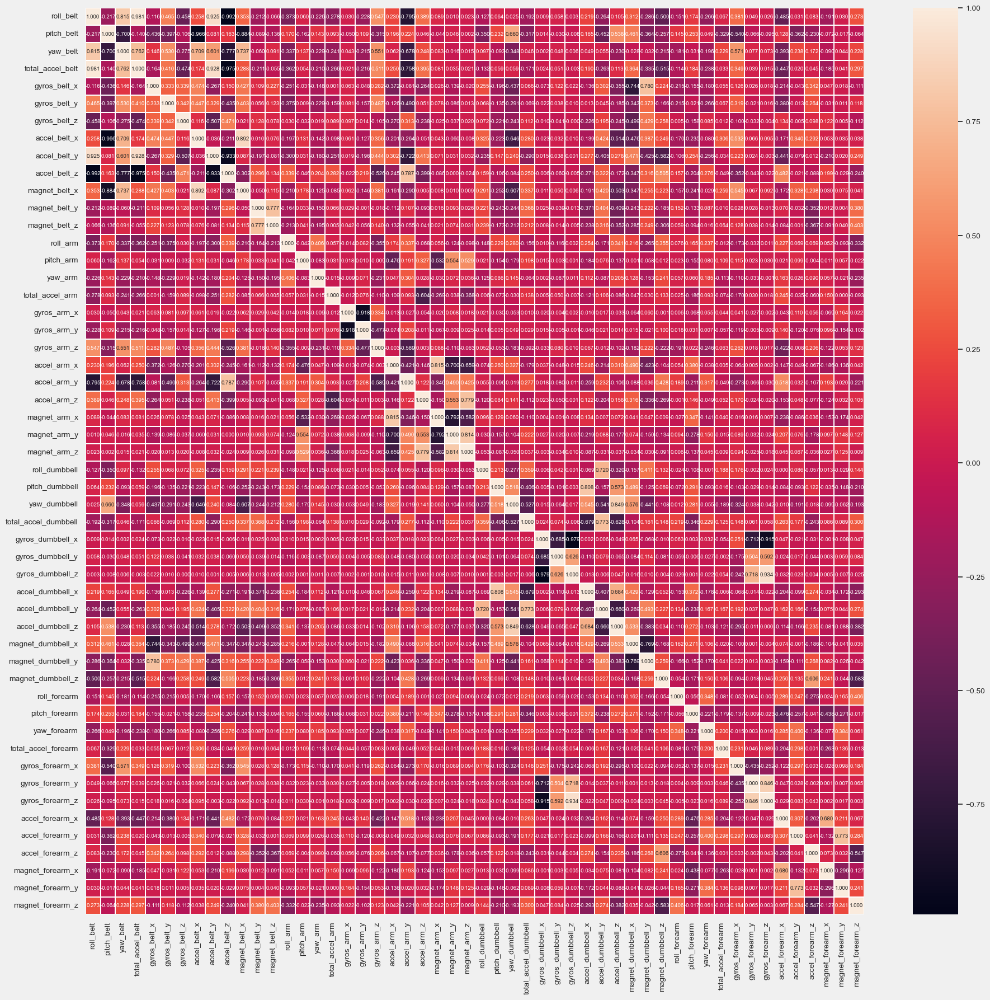

In [ ]:
plt.figure(figsize=(20,20))
sns.set(font_scale=.9)
sns.heatmap(train_df.corr(),annot=True, linewidths=0.1, annot_kws={"size":7}, fmt='.3f')
plt.show()

#### Comment:

- It can be seen that some the variables in the datasets are highly, correlated.
- To identitify the highly correlated variables, we set a threshold of 85\% to identify these variables. That is, if the correlation between two variables is 85\% or greater in absolute value, then we classify these variables as highly correlated, and only one of such variables will be maintained in the model

In [ ]:
corr_matrix = train_df.corr()
corr_matrix = corr_matrix.unstack()
corr_matrix = corr_matrix[abs(corr_matrix) >= 0.85]

print(corr_matrix)

roll_belt             roll_belt               1.000000
                      total_accel_belt        0.980920
                      accel_belt_y            0.924802
                      accel_belt_z           -0.992025
pitch_belt            pitch_belt              1.000000
                      accel_belt_x           -0.965685
                      magnet_belt_x          -0.883835
yaw_belt              yaw_belt                1.000000
total_accel_belt      roll_belt               0.980920
                      total_accel_belt        1.000000
                      accel_belt_y            0.927735
                      accel_belt_z           -0.974949
gyros_belt_x          gyros_belt_x            1.000000
gyros_belt_y          gyros_belt_y            1.000000
gyros_belt_z          gyros_belt_z            1.000000
accel_belt_x          pitch_belt             -0.965685
                      accel_belt_x            1.000000
                      magnet_belt_x           0.891851
accel_belt

#### Comment:

It can be observed that:
- roll_belt bhas a very strong positive linear relationship with total_accel_belt and accel_belt_y. And a very strong negative relationship with accel_belt_z
- pitch_belt has a strong negative linear relationship with accel_belt_x and magnet_belt_x
- total_accel_belt is related both positive and negative to accel_belt_y  and accel_belt_z  respectively
- there is an evidence of a strong positive linear relationship between accel_belt_x and magnet_belt_x'\.
- Similar observations can be made from the correlation matrix output above

### Feature Engineering

There are two encoders **(Label Encoder and One Hot Encoder)** which are parts of the SciKit Learn library in Python, and they are used to convert categorical data, or text data, into numbers, which our predictive models can better understand.

#### Encoding
Only 2 encoding processes need to be done.
1.  to one hot encode the **user** and
2. to label encode the **classe**.

In [ ]:
def Encode_fn(df):
    users=pd.get_dummies(df['user_name']) #OneHot encode username
    df=pd.concat([df, users], axis=1).reset_index(drop=True) #Join to modelling df
    df=df.drop('user_name', axis=1) #Drop original username var
    return(df)

In [ ]:
train_df=Encode_fn(train_df)
test_df=Encode_fn(test_df)

In [ ]:
train_df.head()

,roll_belt,pitch_belt,yaw_belt,total_accel_belt,gyros_belt_x,gyros_belt_y,gyros_belt_z,accel_belt_x,accel_belt_y,accel_belt_z,magnet_belt_x,magnet_belt_y,magnet_belt_z,roll_arm,pitch_arm,yaw_arm,total_accel_arm,gyros_arm_x,gyros_arm_y,gyros_arm_z,accel_arm_x,accel_arm_y,accel_arm_z,magnet_arm_x,magnet_arm_y,magnet_arm_z,roll_dumbbell,pitch_dumbbell,yaw_dumbbell,total_accel_dumbbell,gyros_dumbbell_x,gyros_dumbbell_y,gyros_dumbbell_z,accel_dumbbell_x,accel_dumbbell_y,accel_dumbbell_z,magnet_dumbbell_x,magnet_dumbbell_y,magnet_dumbbell_z,roll_forearm,pitch_forearm,yaw_forearm,total_accel_forearm,gyros_forearm_x,gyros_forearm_y,gyros_forearm_z,accel_forearm_x,accel_forearm_y,accel_forearm_z,magnet_forearm_x,magnet_forearm_y,magnet_forearm_z,classe,adelmo,carlitos,charles,eurico,jeremy,pedro
0,1.41,8.07,-94.4,3,0.00,0.00,-0.02,-21,4,22,-3,599,-313,-128.0,22.5,-161.0,34,0.00,0.00,-0.02,-288,109,-123,-368,337,516,13.052175,-70.494004,-84.873939,37,0.0,-0.02,0.00,-234,47,-271,-559,293,-65.0,28.4,-63.9,-153.0,36,0.03,0.00,-0.02,192,203,-215,-17,654.0,476.0,A,0,1,0,0,0,0
1,1.41,8.07,-94.4,3,0.02,0.00,-0.02,-22,4,22,-7,608,-311,-128.0,22.5,-161.0,34,0.02,-0.02,-0.02,-290,110,-125,-369,337,513,13.130740,-70.637505,-84.710647,37,0.0,-0.02,0.00,-233,47,-269,-555,296,-64.0,28.3,-63.9,-153.0,36,0.02,0.00,-0.02,192,203,-216,-18,661.0,473.0,A,0,1,0,0,0,0
2,1.42,8.07,-94.4,3,0.00,0.00,-0.02,-20,5,23,-2,600,-305,-128.0,22.5,-161.0,34,0.02,-0.02,-0.02,-289,110,-126,-368,344,513,12.850750,-70.278120,-85.140781,37,0.0,-0.02,0.00,-232,46,-270,-561,298,-63.0,28.3,-63.9,-152.0,36,0.03,-0.02,0.00,196,204,-213,-18,658.0,469.0,A,0,1,0,0,0,0
3,1.48,8.05,-94.4,3,0.02,0.00,-0.03,-22,3,21,-6,604,-310,-128.0,22.1,-161.0,34,0.02,-0.03,0.02,-289,111,-123,-372,344,512,13.431200,-70.393795,-84.873626,37,0.0,-0.02,-0.02,-232,48,-269,-552,303,-60.0,28.1,-63.9,-152.0,36,0.02,-0.02,0.00,189,206,-214,-16,658.0,469.0,A,0,1,0,0,0,0
4,1.48,8.07,-94.4,3,0.02,0.02,-0.02,-21,2,24,-6,600,-302,-128.0,22.1,-161.0,34,0.00,-0.03,0.00,-289,111,-123,-374,337,506,13.378716,-70.428560,-84.853057,37,0.0,-0.02,0.00,-233,48,-270,-554,292,-68.0,28.0,-63.9,-152.0,36,0.02,0.00,-0.02,189,206,-214,-17,655.0,473.0,A,0,1,0,0,0,0


In [ ]:
train_df['classe']=train_df['classe'].astype('category') # Ensure the target is cat
train_df['classe']=train_df['classe'].cat.codes # Label encoding
train_df['classe']=train_df['classe'].astype('category') # Ensure the target is cat
#train_df=train_df.drop('classe', axis=1)

In [ ]:
train_df.head()

,roll_belt,pitch_belt,yaw_belt,total_accel_belt,gyros_belt_x,gyros_belt_y,gyros_belt_z,accel_belt_x,accel_belt_y,accel_belt_z,magnet_belt_x,magnet_belt_y,magnet_belt_z,roll_arm,pitch_arm,yaw_arm,total_accel_arm,gyros_arm_x,gyros_arm_y,gyros_arm_z,accel_arm_x,accel_arm_y,accel_arm_z,magnet_arm_x,magnet_arm_y,magnet_arm_z,roll_dumbbell,pitch_dumbbell,yaw_dumbbell,total_accel_dumbbell,gyros_dumbbell_x,gyros_dumbbell_y,gyros_dumbbell_z,accel_dumbbell_x,accel_dumbbell_y,accel_dumbbell_z,magnet_dumbbell_x,magnet_dumbbell_y,magnet_dumbbell_z,roll_forearm,pitch_forearm,yaw_forearm,total_accel_forearm,gyros_forearm_x,gyros_forearm_y,gyros_forearm_z,accel_forearm_x,accel_forearm_y,accel_forearm_z,magnet_forearm_x,magnet_forearm_y,magnet_forearm_z,classe,adelmo,carlitos,charles,eurico,jeremy,pedro
0,1.41,8.07,-94.4,3,0.00,0.00,-0.02,-21,4,22,-3,599,-313,-128.0,22.5,-161.0,34,0.00,0.00,-0.02,-288,109,-123,-368,337,516,13.052175,-70.494004,-84.873939,37,0.0,-0.02,0.00,-234,47,-271,-559,293,-65.0,28.4,-63.9,-153.0,36,0.03,0.00,-0.02,192,203,-215,-17,654.0,476.0,0,0,1,0,0,0,0
1,1.41,8.07,-94.4,3,0.02,0.00,-0.02,-22,4,22,-7,608,-311,-128.0,22.5,-161.0,34,0.02,-0.02,-0.02,-290,110,-125,-369,337,513,13.130740,-70.637505,-84.710647,37,0.0,-0.02,0.00,-233,47,-269,-555,296,-64.0,28.3,-63.9,-153.0,36,0.02,0.00,-0.02,192,203,-216,-18,661.0,473.0,0,0,1,0,0,0,0
2,1.42,8.07,-94.4,3,0.00,0.00,-0.02,-20,5,23,-2,600,-305,-128.0,22.5,-161.0,34,0.02,-0.02,-0.02,-289,110,-126,-368,344,513,12.850750,-70.278120,-85.140781,37,0.0,-0.02,0.00,-232,46,-270,-561,298,-63.0,28.3,-63.9,-152.0,36,0.03,-0.02,0.00,196,204,-213,-18,658.0,469.0,0,0,1,0,0,0,0
3,1.48,8.05,-94.4,3,0.02,0.00,-0.03,-22,3,21,-6,604,-310,-128.0,22.1,-161.0,34,0.02,-0.03,0.02,-289,111,-123,-372,344,512,13.431200,-70.393795,-84.873626,37,0.0,-0.02,-0.02,-232,48,-269,-552,303,-60.0,28.1,-63.9,-152.0,36,0.02,-0.02,0.00,189,206,-214,-16,658.0,469.0,0,0,1,0,0,0,0
4,1.48,8.07,-94.4,3,0.02,0.02,-0.02,-21,2,24,-6,600,-302,-128.0,22.1,-161.0,34,0.00,-0.03,0.00,-289,111,-123,-374,337,506,13.378716,-70.428560,-84.853057,37,0.0,-0.02,0.00,-233,48,-270,-554,292,-68.0,28.0,-63.9,-152.0,36,0.02,0.00,-0.02,189,206,-214,-17,655.0,473.0,0,0,1,0,0,0,0


In [ ]:
def get_encoded_data(data):
    vars_to_dummy = np.array(data.select_dtypes(include=['object', 'bool']).columns)
    new_data = pd.get_dummies(data, columns=vars_to_dummy, dummy_na=True)
    new_data = new_data.fillna(0)

    return new_data

In [ ]:
def get_oversampled_data(X, y):
    sm = SMOTE(sampling_strategy='auto', random_state=7)

    # Fit the model to generate the data.
    X_new, y_new = sm.fit_resample(X, y)

    return X_new, y_new

#### Handling data imbalance

- From above, it was evident that there dataset was imbalanced, as the proportion of class A was more than that of anyother class.

- We used oversampled the data using  "Synthetic Minority Oversampling Technique (SMOT)", to generate a new balanced data set with equal proportions of all classes.

#### REAMRK:

On the modelling stage, we will compare the performance of the various classification models, using both the original unbalanced and synthetic balanced data to determine whether the models performed better on the original or balanced data.

#### Oversampling with SMOTE

**Comment**

To address data imbalance, we are employing smote to do oversampling, instead of oversampling with replacement, for the minority class by producing "synthetic" samples.

In [ ]:
from datetime import datetime
start_time = datetime.now()
from collections import Counter


y_raw = train_df['classe']
X_raw = train_df.drop(columns=['classe'], axis=1)
#X_raw = train_df.drop('classe', axis=1)

# summarize class distribution
print("Before oversampling: ",Counter(y_raw))

# define oversampling strategy
SM = SMOTE(sampling_strategy="auto", random_state=7)

# fit and apply the transform
x_train_SMOTE, y_train_SMOTE = SM.fit_resample(X_raw, y_raw)

# summarize class distribution
print("After oversampling: ",Counter(y_train_SMOTE))

end_time = datetime.now()
print('Duration: {}'.format(end_time - start_time))

Before oversampling:  Counter({0: 5532, 1: 3766, 4: 3571, 2: 3383, 3: 3190})
After oversampling:  Counter({0: 5532, 1: 5532, 2: 5532, 3: 5532, 4: 5532})
Duration: 0:00:01.556765


In [ ]:
x_train_SMOTE.shape

(27660, 58)

In [ ]:
X_raw.shape

(19442, 58)

Balanced data


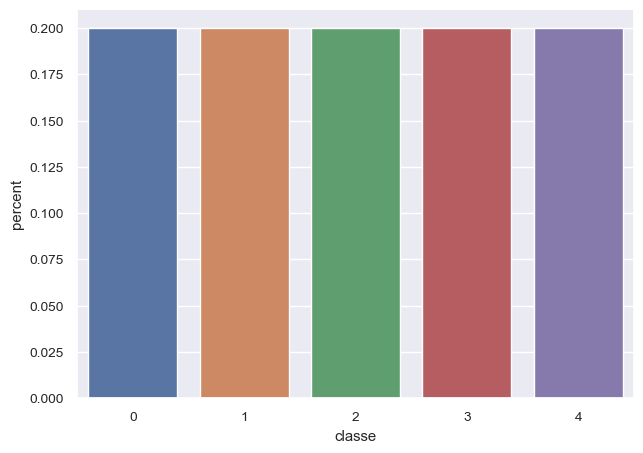

In [ ]:
#y_train = train['classe']
print('Balanced data')
show_classes_distribution(y_train_SMOTE)


### Feature Selection


To help us decide on which features to include in our models, we use both **PCA** and **SelectKBest Feature Selection** to determine the importance of each attribute/feature in our data sets:


#### Principal Component Analysis

##### Choosing the number of components
A vital part of using PCA in practice is the ability to estimate how many components are needed to describe the data. This can be determined by looking at the cumulative explained variance ratio as a function of the number of components:

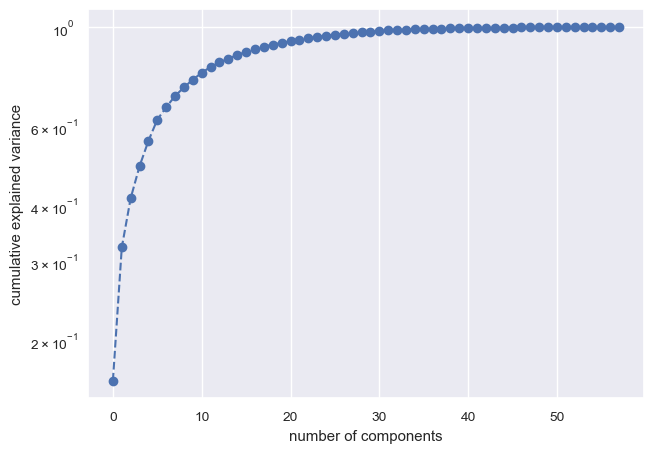

In [ ]:
import sklearn.datasets as ds
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

#pca = PCA().fit(X_train)
#plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');


z_scaler = StandardScaler()
z_data = z_scaler.fit_transform(x_train_SMOTE)
pca_trafo = PCA().fit(z_data);

#plt.semilogy(pca_trafo.explained_variance_ratio_, '--o');
plt.semilogy(pca_trafo.explained_variance_ratio_.cumsum(), '--o');

In [ ]:
explained_variance=pca_trafo.explained_variance_ratio_

pca_trafo11 = PCA(0.95).fit(z_data);
print("The number of components that will give atleast 95% explained variance are: ", pca_trafo11.n_components_)
print("======================================================================")

num = 0
sum_tot = 0
for nu in explained_variance:
    num +=1
    sum_tot= sum_tot + nu
    print('PC # : %d  is %f with cummulative explained variance of  %f' % (num, nu, sum_tot))

The number of components that will give atleast 95% explained variance are:  24
PC # : 1  is 0.163088 with cummulative explained variance of  0.163088
PC # : 2  is 0.159923 with cummulative explained variance of  0.323011
PC # : 3  is 0.092717 with cummulative explained variance of  0.415728
PC # : 4  is 0.074246 with cummulative explained variance of  0.489974
PC # : 5  is 0.068039 with cummulative explained variance of  0.558013
PC # : 6  is 0.064230 with cummulative explained variance of  0.622243
PC # : 7  is 0.040613 with cummulative explained variance of  0.662857
PC # : 8  is 0.039691 with cummulative explained variance of  0.702548
PC # : 9  is 0.031524 with cummulative explained variance of  0.734072
PC # : 10  is 0.030040 with cummulative explained variance of  0.764112
PC # : 11  is 0.026698 with cummulative explained variance of  0.790810
PC # : 12  is 0.024774 with cummulative explained variance of  0.815584
PC # : 13  is 0.018683 with cummulative explained variance of  0.

**Comment**

The above curve quantifies how much of the total, **59-dimensional variance** is contained within the first **N** components. For example, we see that the first **17 components contain approximately 90%** of the variance, while you need about **24** components to describe close to 95% of the variance.

Looking at this plot for a high-dimensional dataset can help you understand the level of redundancy present in multiple observations.

As you can see the first 18 variables/features add significant variance hence droping the variables in this case is not a good idea! But we also know that using all these features could result in an overfitting of our classification models. Hence we will make a trade-off between the variance explained and the attributes to retain in the models.

Here **95%** of the explained variance amounts to **24** principal components. Now we can compute these components, and then use the inverse of the transform to reconstruct the original feature space:

### Feature of Importance

SelectKbest is a method provided by sklearn to rank features of a dataset by their “importance ”with respect to the target variable. This “importance” is calculated using a score function such as - [f_classif]: which computes the ANOVA f-value stats of both negative and non-negative features for classification tasks.

In [ ]:
from sklearn.feature_selection import SelectKBest #Chi-squared test is applicable only for categorical data
from sklearn.feature_selection import chi2
from sklearn.feature_selection import SelectPercentile, f_classif
#apply SelectKBest class to extract top 10 best features
bestfeatures = SelectKBest(score_func=f_classif, k=24)
fit = bestfeatures.fit(x_train_SMOTE, y_train_SMOTE)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(x_train_SMOTE.columns)
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Specs','Score']  #naming the dataframe columns
print(featureScores.nlargest(24,'Score'))  #print 24 best features

                   Specs        Score
40         pitch_forearm  1559.224269
11         magnet_belt_y   904.097316
23          magnet_arm_x   839.180363
26         roll_dumbbell   697.584661
24          magnet_arm_y   613.359462
27        pitch_dumbbell   606.444285
20           accel_arm_x   589.736600
46       accel_forearm_x   587.801191
33      accel_dumbbell_x   520.365426
25          magnet_arm_z   473.304030
49      magnet_forearm_x   448.068439
12         magnet_belt_z   416.189615
14             pitch_arm   271.250320
50      magnet_forearm_y   248.030338
34      accel_dumbbell_y   172.522764
13              roll_arm   170.640936
42   total_accel_forearm   168.135694
38     magnet_dumbbell_z   157.666141
36     magnet_dumbbell_x   157.614933
16       total_accel_arm   151.443252
35      accel_dumbbell_z   148.072885
29  total_accel_dumbbell   123.590218
47       accel_forearm_y   119.316336
22           accel_arm_z   118.574508


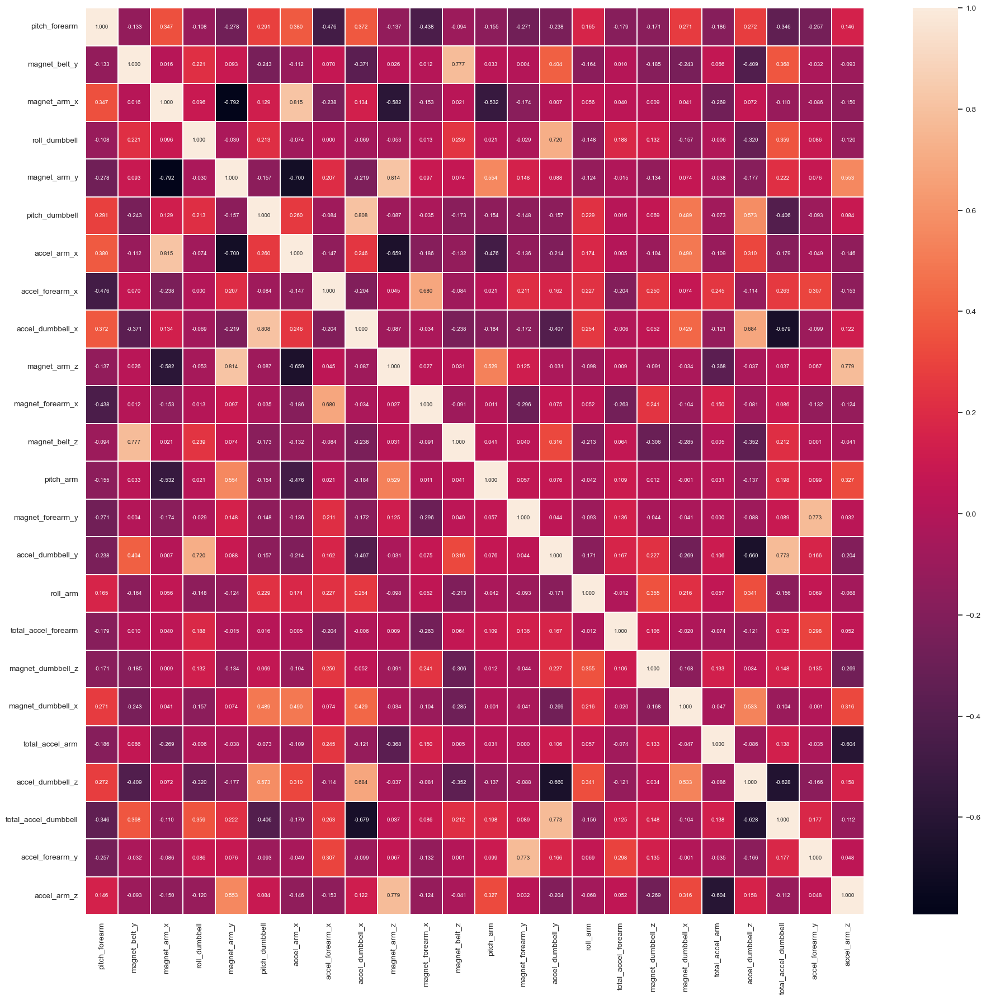

In [ ]:
colss= featureScores.nlargest(24,'Score')
aaa = list(colss['Specs'])
train_df_11=train_df[aaa]
train_col =train_df_1.columns
test_df_11 = test_df[aaa]


plt.figure(figsize=(20,20))
sns.set(font_scale=.9)
sns.heatmap(train_df_11.corr(),annot=True, linewidths=0.1, annot_kws={"size":7}, fmt='.3f')
plt.show()

#### Comment:

From the correlation plot of the selected variables using the SelectKBest from sklearn, it can be observed that highly correlated variables have been dropped in order to reduced multicolinearity.

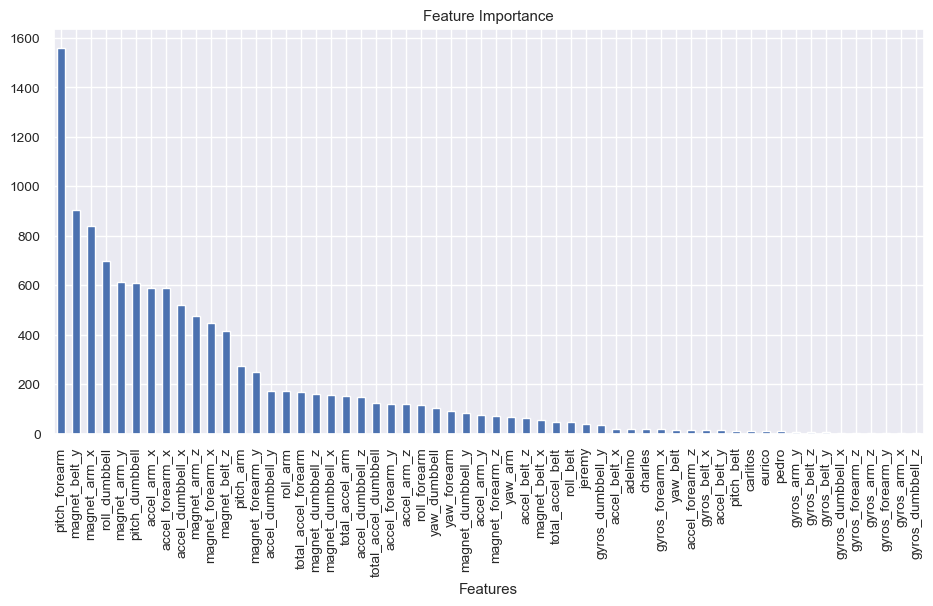

In [ ]:
colss_1= featureScores.nlargest(58,'Score')
colss_1.plot(x = "Specs", y = "Score", kind = "bar", figsize = (10, 5), legend = False)
plt.title("Feature Importance")
plt.xlabel("Features")
#plt.ylabel("Death Rate")
plt.show()

#### Comment:
The plot above list the most important features from the most significant to the least significant. It can be seen that the contribution of "pitch_forearm" as much as twice that of the 2nd highest (i.e magnet_belt_y)

### Other approaches of determining the important features

### Feature Importance
To evaluate the significance of features, bagged decision trees like Random Forest and Extra Trees can be employed.  We create an ExtraTreesClassifier classifier on the dataset in the implementation that follows.  The scikit-learn API contains more information on the ExtraTreesClassifier class.  

This class implements a meta estimator that employs averaging to increase predictive accuracy and reduce overfitting. The meta estimator fits a number of randomized decision trees (also known as extra-trees) on different sub-samples of the dataset.


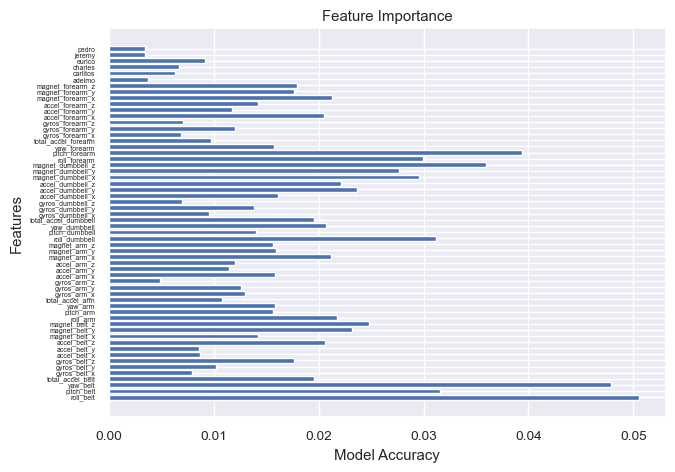

In [ ]:
# fit an Extra Tree model to the data
extree = ExtraTreesClassifier()
extree.fit(x_train_SMOTE, y_train_SMOTE)

# display the relative importance of each attribute
relval = extree.feature_importances_

# horizontal bar plot of feature importance
pos = np.arange(58) + 20.0
plt.barh(pos, relval, align = 'center')
plt.title("Feature Importance")
plt.xlabel("Model Accuracy")
plt.ylabel("Features")
plt.yticks(pos, (['roll_belt', 'pitch_belt', 'yaw_belt', 'total_accel_belt',
       'gyros_belt_x', 'gyros_belt_y', 'gyros_belt_z', 'accel_belt_x',
       'accel_belt_y', 'accel_belt_z', 'magnet_belt_x', 'magnet_belt_y',
       'magnet_belt_z', 'roll_arm', 'pitch_arm', 'yaw_arm', 'total_accel_arm',
       'gyros_arm_x', 'gyros_arm_y', 'gyros_arm_z', 'accel_arm_x',
       'accel_arm_y', 'accel_arm_z', 'magnet_arm_x', 'magnet_arm_y',
       'magnet_arm_z', 'roll_dumbbell', 'pitch_dumbbell', 'yaw_dumbbell',
       'total_accel_dumbbell', 'gyros_dumbbell_x', 'gyros_dumbbell_y',
       'gyros_dumbbell_z', 'accel_dumbbell_x', 'accel_dumbbell_y',
       'accel_dumbbell_z', 'magnet_dumbbell_x', 'magnet_dumbbell_y',
       'magnet_dumbbell_z', 'roll_forearm', 'pitch_forearm', 'yaw_forearm',
       'total_accel_forearm', 'gyros_forearm_x', 'gyros_forearm_y',
       'gyros_forearm_z', 'accel_forearm_x', 'accel_forearm_y',
       'accel_forearm_z', 'magnet_forearm_x', 'magnet_forearm_y',
       'magnet_forearm_z', 'adelmo', 'carlitos', 'charles', 'eurico', 'jeremy',
       'pedro']),fontsize=5)
plt.grid(True)

In [ ]:
print(relval)

[0.05053613 0.0315901  0.04785305 0.0195949  0.00792979 0.0102401
 0.01770177 0.00872847 0.00855389 0.02057632 0.01423832 0.0231581
 0.02484048 0.02172069 0.01563978 0.01587434 0.0108228  0.01294869
 0.01256724 0.00486048 0.01582399 0.01143899 0.01201217 0.02121025
 0.01597473 0.01566916 0.03116916 0.01406706 0.02070529 0.01953428
 0.00950875 0.01379909 0.00700949 0.01615726 0.02364453 0.02209237
 0.02956986 0.02770695 0.03592739 0.02995864 0.03936964 0.01572219
 0.00975954 0.00685403 0.01205729 0.00706018 0.02056003 0.01176202
 0.01419053 0.0212521  0.0176801  0.01790412 0.00371862 0.00634109
 0.00664738 0.00921754 0.00345653 0.00349223]


In [ ]:
rel_rank = sorted(range(len(relval)),key=relval.__getitem__, reverse = True)
feat_imp_rank = x_train_SMOTE.iloc[:, rel_rank[0:59]]
feat_imp_rank.columns

Index(['roll_belt', 'yaw_belt', 'pitch_forearm', 'magnet_dumbbell_z',
       'pitch_belt', 'roll_dumbbell', 'roll_forearm', 'magnet_dumbbell_x',
       'magnet_dumbbell_y', 'magnet_belt_z', 'accel_dumbbell_y',
       'magnet_belt_y', 'accel_dumbbell_z', 'roll_arm', 'magnet_forearm_x',
       'magnet_arm_x', 'yaw_dumbbell', 'accel_belt_z', 'accel_forearm_x',
       'total_accel_belt', 'total_accel_dumbbell', 'magnet_forearm_z',
       'gyros_belt_z', 'magnet_forearm_y', 'accel_dumbbell_x', 'magnet_arm_y',
       'yaw_arm', 'accel_arm_x', 'yaw_forearm', 'magnet_arm_z', 'pitch_arm',
       'magnet_belt_x', 'accel_forearm_z', 'pitch_dumbbell',
       'gyros_dumbbell_y', 'gyros_arm_x', 'gyros_arm_y', 'gyros_forearm_y',
       'accel_arm_z', 'accel_forearm_y', 'accel_arm_y', 'total_accel_arm',
       'gyros_belt_y', 'total_accel_forearm', 'gyros_dumbbell_x', 'eurico',
       'accel_belt_x', 'accel_belt_y', 'gyros_belt_x', 'gyros_forearm_z',
       'gyros_dumbbell_z', 'gyros_forearm_x', 'char

#### Feature ranking with recursive feature elimination (RFE).
Recursively deleting attributes and then creating a model based on the ones that remain is how the Recursive Feature Elimination (or RFE) algorithm functions.

The attributes (and attribute combinations) that are most effective in predicting the target attribute are determined using the model's accuracy.

Recursive feature elimination (RFE) aims to pick features by repeatedly taking into account smaller and smaller sets of features, given an external estimator that assigns weights to features (for example, the coefficients of a linear model). The importance of each feature is first determined by training the estimator on the original set of features, either using the coef_ attribute or the feature importances_ attribute. The least crucial features are then removed from the present list of features.
Once the appropriate number of features to pick has been reached, the technique is recursively repeated on the pruned set.

In [ ]:
# create a base classifier used to evaluate a subset of attributes
logreg = LogisticRegression()

# create the RFE model and select 22 attributes
rfe = RFE(logreg)
rfe_fit = rfe.fit(x_train_SMOTE, y_train_SMOTE)

# summarize the selection of the attributes
print("Number Features: ", rfe_fit.n_features_)
print("Selected Features: ",  rfe_fit.support_)
print("Feature Ranking: ", rfe_fit.ranking_)

Number Features:  29
Selected Features:  [ True  True  True  True False False False  True  True  True  True  True
  True False  True False  True False False False  True  True  True False
  True  True  True  True  True  True False False False  True  True  True
  True False  True False  True False  True False False False False False
  True False False False False False False False False False]
Feature Ranking:  [ 1  1  1  1 25 30 23  1  1  1  1  1  1  3  1  8  1 12 15 26  1  1  1  7
  1  1  1  1  1  1 17 20 18  1  1  1  1  2  1  4  1  6  1 19 14 16  5 13
  1  9 10 11 21 29 22 27 24 28]


In [ ]:
imp_59 = sorted(range(len(rfe_fit.ranking_)),key=rfe_fit.ranking_.__getitem__, reverse = False)
feat_imp=x_train_SMOTE.iloc[:, imp_59[0:59]]
feat_imp.columns

Index(['roll_belt', 'pitch_belt', 'yaw_belt', 'total_accel_belt',
       'accel_belt_x', 'accel_belt_y', 'accel_belt_z', 'magnet_belt_x',
       'magnet_belt_y', 'magnet_belt_z', 'pitch_arm', 'total_accel_arm',
       'accel_arm_x', 'accel_arm_y', 'accel_arm_z', 'magnet_arm_y',
       'magnet_arm_z', 'roll_dumbbell', 'pitch_dumbbell', 'yaw_dumbbell',
       'total_accel_dumbbell', 'accel_dumbbell_x', 'accel_dumbbell_y',
       'accel_dumbbell_z', 'magnet_dumbbell_x', 'magnet_dumbbell_z',
       'pitch_forearm', 'total_accel_forearm', 'accel_forearm_z',
       'magnet_dumbbell_y', 'roll_arm', 'roll_forearm', 'accel_forearm_x',
       'yaw_forearm', 'magnet_arm_x', 'yaw_arm', 'magnet_forearm_x',
       'magnet_forearm_y', 'magnet_forearm_z', 'gyros_arm_x',
       'accel_forearm_y', 'gyros_forearm_y', 'gyros_arm_y', 'gyros_forearm_z',
       'gyros_dumbbell_x', 'gyros_dumbbell_z', 'gyros_forearm_x',
       'gyros_dumbbell_y', 'adelmo', 'charles', 'gyros_belt_z', 'jeremy',
       'gyros_be

# Modeling

In this project, the following multi-class classification algorithms will be used:
- Decision trees
- KNN
- Random Forest
- Gradient Boosting
- Logistic Regression (although primarily used for binary classification, it can be extended to handle multi-class classification through techniques such as One-vs-Rest or One-vs-One)

#### Splitting training set into train and test data

As per the procedure in all data mining project, we split the train set further into training and test set, to help our analyze the performance of the chosen model

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
colss= featureScores.nlargest(24,'Score') # Getting the first 24 most important features
aaa = list(colss['Specs'])                # The column names of the top 24 features
train_df_raw=X_raw[aaa]
train_df_smote = x_train_SMOTE[aaa]
#train_col =train_df_1.columns
test_df_ori = test_df[aaa]

X_train, X_test, y_train, y_test = train_test_split(train_df_raw, y_raw, test_size = 0.2, random_state = 42)
X_train_sm, X_test_sm, y_train_sm, y_test_sm = train_test_split(train_df_smote, y_train_SMOTE, test_size = 0.2, random_state = 42)

### Evaluation Criteria

In [ ]:
from sklearn.metrics import roc_curve

def evaluate_model(model, x_test, y_test):
    from sklearn import metrics

    # Predict Test Data
    y_pred = model.predict(x_test)

    # Calculate accuracy, precision, recall, f1-score, and kappa score
    acc = metrics.accuracy_score(y_test, y_pred)

    prec = metrics.precision_score(y_test, y_pred, average='weighted')
    rec = metrics.recall_score(y_test, y_pred, average='weighted')
    f1 = metrics.f1_score(y_test, y_pred, average='weighted')

    # Display confussion matrix
    cm = metrics.confusion_matrix(y_test, y_pred)

    return {'acc': acc, 'prec': prec, 'rec': rec, 'f1': f1, 'cm': cm}

## Decision Tree

Results for Unbalanced/Original data
Accuracy: 0.9058884031884803
Precision: 0.9059862913592811
Recall: 0.9058884031884803
F1 Score: 0.9056665827955676
Confusion Matrix:
 [[1030   26    7   16    9]
 [  33  669   33   14   40]
 [  11   28  608   23   13]
 [  12    9   31  576   18]
 [   7   14   15    7  640]]


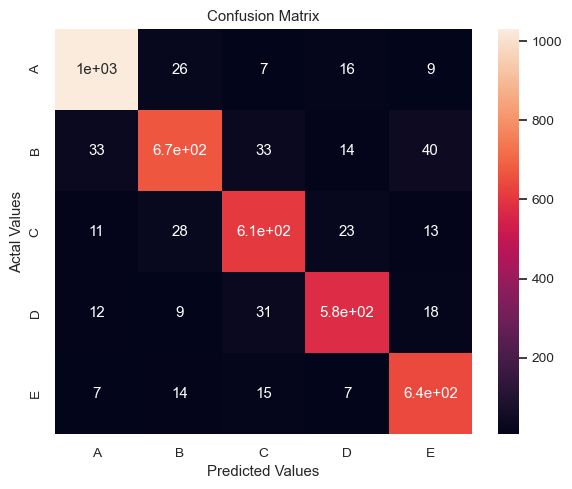

In [ ]:
from sklearn import tree
dtc = tree.DecisionTreeClassifier(random_state=0)
dtc.fit(X_train, y_train)

# Evaluate Model
dtc_eval = evaluate_model(dtc,X_test, y_test)

print("Results for Unbalanced/Original data")
print("="*40)
print('Accuracy:', dtc_eval['acc'])
print('Precision:', dtc_eval['prec'])
print('Recall:', dtc_eval['rec'])
print('F1 Score:', dtc_eval['f1'])
print('Confusion Matrix:\n', dtc_eval['cm'])

cm_dtc = pd.DataFrame(dtc_eval['cm'],
                     index = ['A','B','C', 'D', 'E'],
                     columns = ['A','B','C', 'D', 'E'])

#Plotting the confusion matrix
plt.figure(figsize=(6,5))
sns.heatmap(cm_dtc, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

#### Comment:

- The accuracy of the Decision tree on the original data was 90.59%.
- Which is aproximately the same for the other performance metric considered.
- From the confusion matrix, the false negative **"NF"** for class A is $26+7+16+9 = 58$ and false positives **FP** of $33+11+12+7=63$
- Similar analysis can be made for the other 4 classes

Results for Balanced data
Accuracy: 0.9649313087490962
Precision: 0.9649469756973359
Recall: 0.9649313087490962
F1 Score: 0.9649132920797773
Confusion Matrix:
 [[1070   15    2    8    6]
 [  21 1059   13    6   15]
 [   7   20 1106   10    7]
 [   6    3   24 1058    9]
 [   8    7    3    4 1045]]


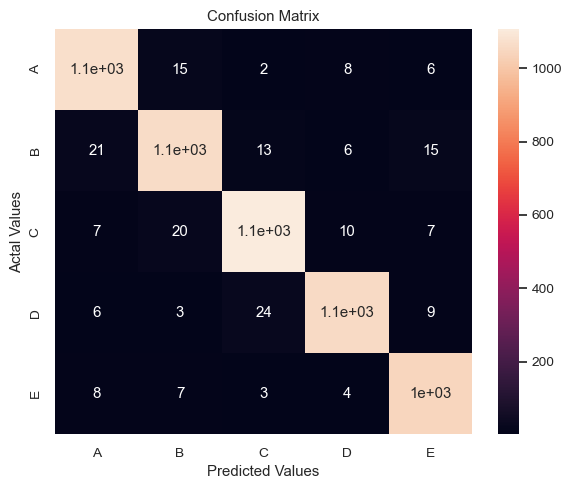

In [ ]:
from sklearn import tree
dtc_sm = tree.DecisionTreeClassifier(random_state=0)
dtc_sm.fit(X_train_sm, y_train_sm)

# Evaluate Model
dtc_sm_eval = evaluate_model(dtc,X_test_sm, y_test_sm)

print("Results for Balanced data")
print("="*40)
print('Accuracy:', dtc_sm_eval['acc'])
print('Precision:', dtc_sm_eval['prec'])
print('Recall:', dtc_sm_eval['rec'])
print('F1 Score:', dtc_sm_eval['f1'])
print('Confusion Matrix:\n', dtc_sm_eval['cm'])

cm_dtc_sm = pd.DataFrame(dtc_sm_eval['cm'],
                     index = ['A','B','C', 'D', 'E'],
                     columns = ['A','B','C', 'D', 'E'])

#Plotting the confusion matrix
plt.figure(figsize=(6,5))
sns.heatmap(cm_dtc_sm, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

#### Comment:
- Now using the balanced data to train the model, there was a 5.9% increase in the performance of the Decision Tree model.
- This increase in the performance could be attributed to the fact that, now there is equal proportion of all classes in the trainset hence the model is not bias towards one class
- Also, there is an evidence of a massive improvements in the recall.
- From the confusion matrix, it is observed that the false negative **"NF"** for class A is $15+2+8+6 = 31$ and false positives **FP** of $21+7+6+8=42$

#### REMARK:

- Next we used a gridsearch to hypertune the parameters, to examine if there will be an increment in the performance of the model on the original data.
- Here, we looped through different tree depths


In [ ]:
#Calculate the accuracy with different tree depths to identify the maximum
start_time2 = datetime.now()

#define arrays for storing the scores
dt_range = np.arange(1,21)
scores_dt = []

for k in dt_range:

    #Create Decision tree model and train it
    dt_mdl = DecisionTreeClassifier(criterion = "entropy",max_depth = k)
    dt_mdl.fit(X_train, y_train)

    #Use test set to get prediction values
    dt_yhat = dt_mdl.predict(X_test)
    scores_dt.append(metrics.accuracy_score(y_test, dt_yhat))
print(scores_dt.index(max(scores_dt))+1, max(scores_dt))

end_time2 = datetime.now()
print('Duration: {}'.format(end_time2 - start_time2))

19 0.9192594497300077
Duration: 0:00:11.881915


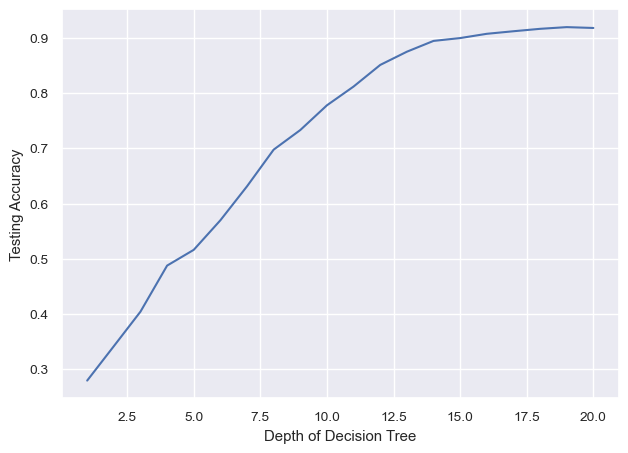

In [ ]:
#Plot model accuracy for different depths of the tree
plt.plot(dt_range, scores_dt)
plt.ylabel('Testing Accuracy')
plt.xlabel('Depth of Decision Tree')
plt.grid(True)

#### Comment:
- The best performing parameters for the Decision Tree on the original data is when $k= depth = 19$.
- Hence this parameter value will be used in the model comparison stage.

### KNN
#### Building KNN model

Results for Unbalanced/Original data
Accuracy: 0.8876317819490872
Precision: 0.8895960788770291
Recall: 0.8876317819490872
F1 Score: 0.8875632175701865
Confusion Matrix:
 [[1039   11   15   20    3]
 [  46  654   48   26   15]
 [  16   27  610   25    5]
 [  15    7   50  565    9]
 [  16   35   21   27  584]]


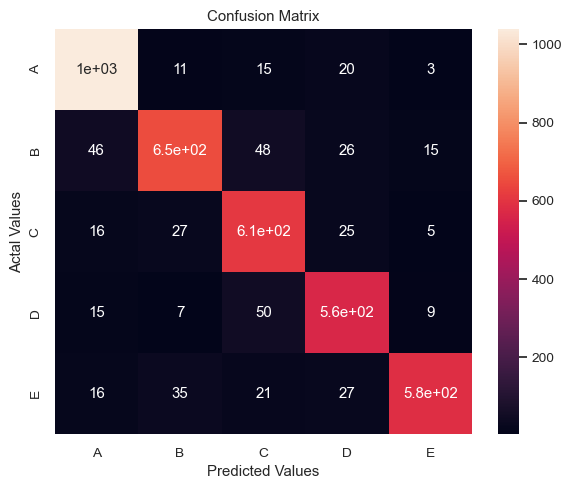

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier()
knn.fit(X_train, y_train)

# Evaluate Model
knn_eval = evaluate_model(knn, X_test, y_test)

print("Results for Unbalanced/Original data")
print("="*40)
print('Accuracy:', knn_eval['acc'])
print('Precision:', knn_eval['prec'])
print('Recall:', knn_eval['rec'])
print('F1 Score:', knn_eval['f1'])
#print('Area Under Curve:', knn_eval['auc'])
print('Confusion Matrix:\n', knn_eval['cm'])

cm_knn = pd.DataFrame(knn_eval['cm'],
                     index = ['A','B','C', 'D', 'E'],
                     columns = ['A','B','C', 'D', 'E'])

#Plotting the confusion matrix
plt.figure(figsize=(6,5))
sns.heatmap(cm_knn, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()



#### Comment:

- The accuracy of the KNN on the original data was 88.76%.
- Which is aproximately the same for the other performance metric considered.

#### REMARK:

- Next we used a gridsearch to hypertune the parameters, to examine if there will be an increment in the performance of the model on the original data.
- Here, we looped through different k-neighbors

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
import time
from datetime import datetime
start_time = datetime.now()
# do your work here

#time_start = time.clock()
#run your code

k_range = np.arange(1, 16)
scores = []
for k in k_range:
    knn = KNeighborsClassifier(n_neighbors=k)
    knn.fit(X_train, y_train)
    y_pred = knn.predict(X_test)
    scores.append(metrics.accuracy_score(y_test, y_pred))
print(scores.index(max(scores))+1 , max(scores))

end_time = datetime.now()
print('Duration: {}'.format(end_time - start_time))

1 0.9537156081254822
Duration: 0:00:08.987876


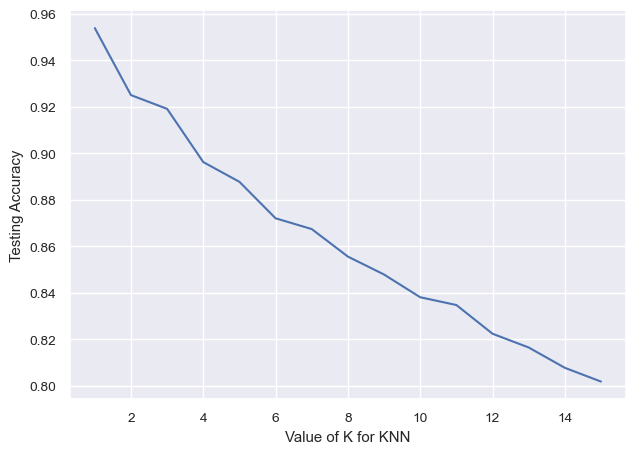

In [ ]:
# plot the relationship between K and testing accuracy
plt.plot(k_range, scores)
plt.xlabel('Value of K for KNN')
plt.ylabel('Testing Accuracy')
plt.grid(True)

#### Comment:
- it can be observed that, the best performing parameters for KNN on the original data is when $k= neighbor = 1$.
- It is very interesting to see that as k increases the accuracy of the model decreases.
- Hence this parameter value will be used in the model comparison stage.

Results for Balanced data
Accuracy: 0.8271872740419378
Precision: 0.8337428013419091
Recall: 0.8271872740419378
F1 Score: 0.8268250702916432
Confusion Matrix:
 [[1014   17   28   37    5]
 [  98  849   94   45   28]
 [  39   48 1020   20   23]
 [  58   14  150  870    8]
 [  31   76   60   77  823]]


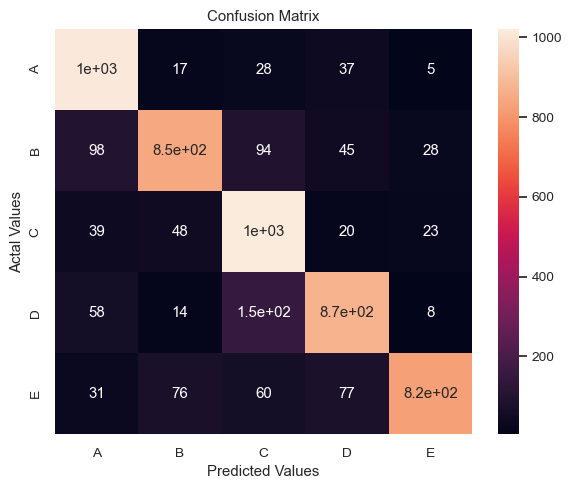

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
knn_sm = KNeighborsClassifier()
knn_sm.fit(X_train_sm, y_train_sm)

# Evaluate Model
knn_sm_eval = evaluate_model(knn, X_test_sm, y_test_sm)

print("Results for Balanced data")
print("="*40)
print('Accuracy:', knn_sm_eval['acc'])
print('Precision:', knn_sm_eval['prec'])
print('Recall:', knn_sm_eval['rec'])
print('F1 Score:', knn_sm_eval['f1'])
#print('Area Under Curve:', knn_eval['auc'])
print('Confusion Matrix:\n', knn_sm_eval['cm'])

cm_knn_sm = pd.DataFrame(knn_sm_eval['cm'],
                     index = ['A','B','C', 'D', 'E'],
                     columns = ['A','B','C', 'D', 'E'])

#Plotting the confusion matrix
plt.figure(figsize=(6,5))
sns.heatmap(cm_knn_sm, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

#### Comment:
- Now using the balanced data to train the model, there was a 6.04% decrease/reduction in the performance of the KNN model.
- This reduction  in the performance could be attributed to the fact of either, loss in discriminative power, or Increasesed bias/variance  ow there is equal proportion of all classes in the trainset hence the model is not bias towards one class

### Random Forest

Results for Unbalanced/Original data
Accuracy: 0.9766006685523271
Precision: 0.9768344514204941
Recall: 0.9766006685523271
F1 Score: 0.9765824104337881
Confusion Matrix:
 [[1084    3    0    1    0]
 [  20  757   10    0    2]
 [   0   14  669    0    0]
 [   1    0   25  615    5]
 [   0    2    2    6  673]]


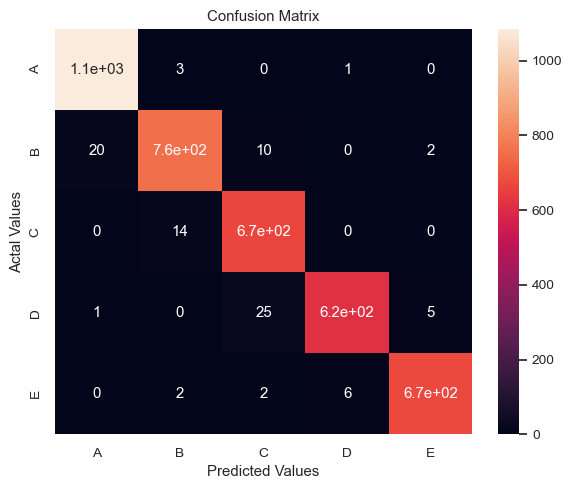

In [ ]:
rf = RandomForestClassifier(n_estimators=100, random_state=7)
rf.fit(X_train, y_train)

# Evaluate Model
rf_eval = evaluate_model(rf, X_test, y_test)

print("Results for Unbalanced/Original data")
print("="*40)
print('Accuracy:', rf_eval['acc'])
print('Precision:', rf_eval['prec'])
print('Recall:', rf_eval['rec'])
print('F1 Score:', rf_eval['f1'])
print('Confusion Matrix:\n', rf_eval['cm'])

cm_rf = pd.DataFrame(rf_eval['cm'],
                     index = ['A','B','C', 'D', 'E'],
                     columns = ['A','B','C', 'D', 'E'])

#Plotting the confusion matrix
plt.figure(figsize=(6,5))
sns.heatmap(cm_rf, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

#### Comment:

- The accuracy of the Random Forest on the original data was 97.66%.
- Which is aproximately the same for the other performance metric considered.
- Since we are interested in correctly predicting the diffrent classes, a very recall value is very much appreciated.
- From the confusion matrix, it can be seen that, the **FN** for class A is $3+1=4$, with an **FP** of $1$.
- Overall, it can be said that, the model wrongly classified:
    - 3 class B and 1 class C as class A
    - 20 and 1 as classes B an C respectively instead of class A.
    - 14 class B as class C and
    - 2 of each class B and C as class E and also wrongly classified 6 of class D as class E

Results for Balanced data
Accuracy: 0.9922270426608821
Precision: 0.9922615059197086
Recall: 0.9922270426608821
F1 Score: 0.9922264280083064
Confusion Matrix:
 [[1099    1    0    1    0]
 [  10 1098    4    0    2]
 [   1    5 1143    1    0]
 [   0    0   14 1085    1]
 [   0    0    1    2 1064]]


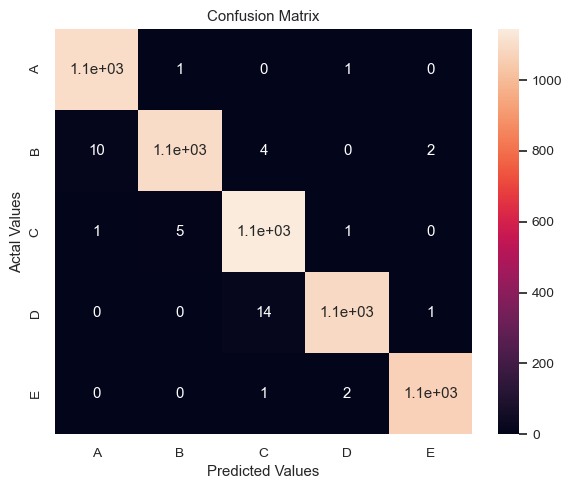

In [ ]:
rf_sm = RandomForestClassifier(n_estimators=100, random_state=7)
rf_sm.fit(X_train_sm, y_train_sm)

# Evaluate Model
rf_sm_eval = evaluate_model(rf, X_test_sm, y_test_sm)

print("Results for Balanced data")
print("="*40)
print('Accuracy:', rf_sm_eval['acc'])
print('Precision:', rf_sm_eval['prec'])
print('Recall:', rf_sm_eval['rec'])
print('F1 Score:', rf_sm_eval['f1'])
print('Confusion Matrix:\n', rf_sm_eval['cm'])

cm_rf_sm = pd.DataFrame(rf_sm_eval['cm'],
                     index = ['A','B','C', 'D', 'E'],
                     columns = ['A','B','C', 'D', 'E'])

#Plotting the confusion matrix
plt.figure(figsize=(6,5))
sns.heatmap(cm_rf_sm, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

#### Comment:

As we would expect, the accuracy on the balanced data is 99.22%, which is a 1.62% increase on the performace using the original data set.

### Gradient Boosting

Results for Unbalanced/Original data
Accuracy: 0.8986886088968886
Precision: 0.9008275707818417
Recall: 0.8986886088968886
F1 Score: 0.8986533512080883
Confusion Matrix:
 [[1055   10    5   15    3]
 [  56  665   52    9    7]
 [  12   44  619    4    4]
 [   9   10   53  563   11]
 [   7   22   29   32  593]]


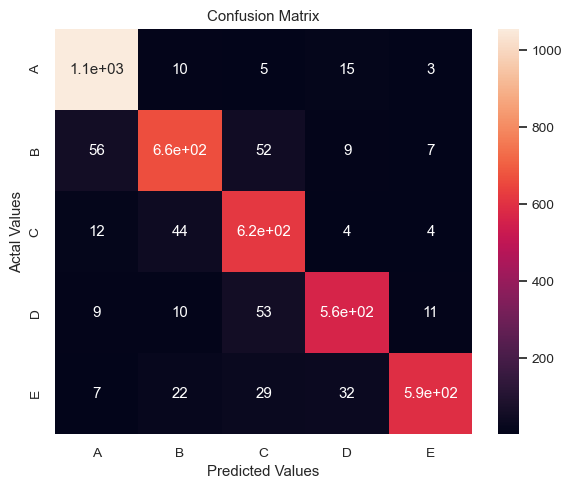

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
gb = GradientBoostingClassifier(learning_rate=0.1)
gb.fit(X_train, y_train)

# Evaluate Model
gb_eval = evaluate_model(gb, X_test, y_test)

print("Results for Unbalanced/Original data")
print("="*40)
print('Accuracy:', gb_eval['acc'])
print('Precision:', gb_eval['prec'])
print('Recall:', gb_eval['rec'])
print('F1 Score:', gb_eval['f1'])
print('Confusion Matrix:\n', gb_eval['cm'])

cm_gb = pd.DataFrame(gb_eval['cm'],
                     index = ['A','B','C', 'D', 'E'],
                     columns = ['A','B','C', 'D', 'E'])

#Plotting the confusion matrix
plt.figure(figsize=(6,5))
sns.heatmap(cm_gb, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

Results for Balance data
Accuracy: 0.9094360086767896
Precision: 0.9121484015137238
Recall: 0.9094360086767896
F1 Score: 0.8986533512080883
Confusion Matrix:
 [[1067   12    6   10    6]
 [  68  972   50   13   11]
 [  15   42 1081    7    5]
 [  10   14  101  968    7]
 [  13   39   37   35  943]]


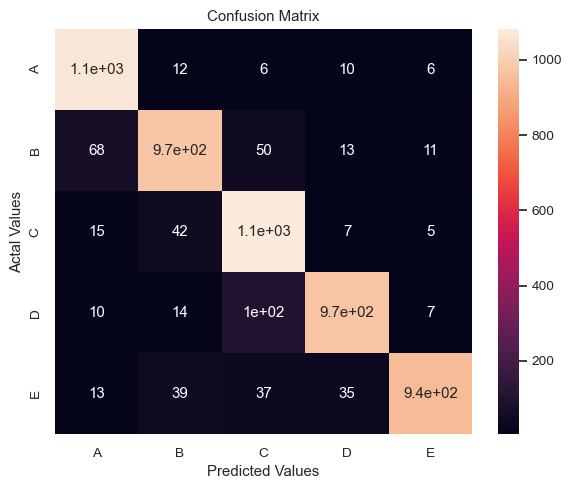

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
gb_sm = GradientBoostingClassifier(learning_rate=0.1)
gb_sm.fit(X_train_sm, y_train_sm)

# Evaluate Model
gb_sm_eval = evaluate_model(gb, X_test_sm, y_test_sm)

print("Results for Balance data")
print("="*40)
print('Accuracy:', gb_sm_eval['acc'])
print('Precision:', gb_sm_eval['prec'])
print('Recall:', gb_sm_eval['rec'])
print('F1 Score:', gb_eval['f1'])
print('Confusion Matrix:\n', gb_sm_eval['cm'])

cm_gb_sm = pd.DataFrame(gb_sm_eval['cm'],
                     index = ['A','B','C', 'D', 'E'],
                     columns = ['A','B','C', 'D', 'E'])

#Plotting the confusion matrix
plt.figure(figsize=(6,5))
sns.heatmap(cm_gb_sm, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

#### Comment:

From the above results, it can be seen that the accuracy of the Gradient Boosting algorithm when applied to the original model is 89.92% and when applied on the balanced data is 90.94%, resulting in an increase in performance of about 1.02%

### LOGISTIC REGRESSION

#### Building logistic regression model

Results for Unbalanced/Original data
Accuracy: 0.5914116739521728
Precision: 0.5893779658847983
Recall: 0.5914116739521728
F1 Score: 0.5882091709399349
Confusion Matrix:
 [[795  54  89 111  39]
 [132 424 110  28  95]
 [166  72 343  77  25]
 [ 52  31  71 412  80]
 [ 80 123  61  93 326]]


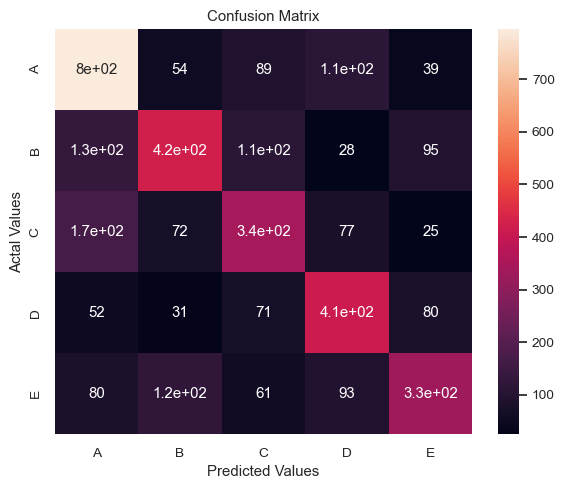

In [ ]:
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression(multi_class = "multinomial")
lr.fit(X_train, y_train)
# Evaluate Model
lr_eval = evaluate_model(lr, X_test, y_test)

print("Results for Unbalanced/Original data")
print("="*40)
print('Accuracy:', lr_eval['acc'])
print('Precision:', lr_eval['prec'])
print('Recall:', lr_eval['rec'])
print('F1 Score:', lr_eval['f1'])
print('Confusion Matrix:\n', lr_eval['cm'])

cm_lr = pd.DataFrame(lr_eval['cm'],
                     index = ['A','B','C', 'D', 'E'],
                     columns = ['A','B','C', 'D', 'E'])

#Plotting the confusion matrix
plt.figure(figsize=(6,5))
sns.heatmap(cm_lr, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

Results for Balanced data
Accuracy: 0.571945046999277
Precision: 0.5756159313557278
Recall: 0.571945046999277
F1 Score: 0.5683112811123033
Confusion Matrix:
 [[797  58  89 116  41]
 [194 603 157  40 120]
 [250 134 604 129  33]
 [ 86  60 143 696 115]
 [160 226  89 128 464]]


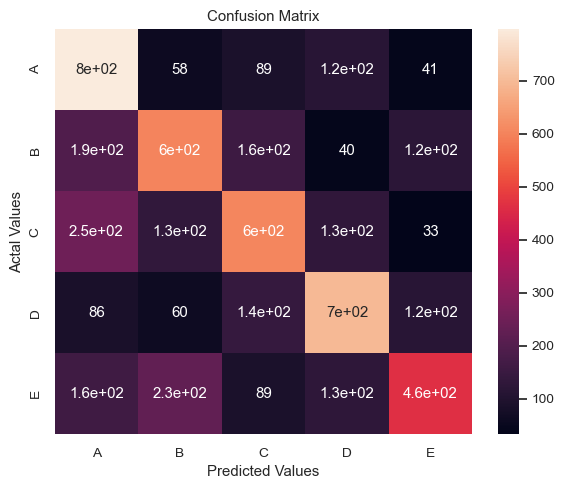

In [ ]:
from sklearn.linear_model import LogisticRegression
lr_sm = LogisticRegression(multi_class = "multinomial")
lr_sm.fit(X_train_sm, y_train_sm)
# Evaluate Model
lr_sm_eval = evaluate_model(lr, X_test_sm, y_test_sm)
# Print result

print("Results for Balanced data")
print("="*40)
print('Accuracy:', lr_sm_eval['acc'])
print('Precision:', lr_sm_eval['prec'])
print('Recall:', lr_sm_eval['rec'])
print('F1 Score:', lr_sm_eval['f1'])
print('Confusion Matrix:\n', lr_sm_eval['cm'])

cm_lr_sm = pd.DataFrame(lr_sm_eval['cm'],
                     index = ['A','B','C', 'D', 'E'],
                     columns = ['A','B','C', 'D', 'E'])

#Plotting the confusion matrix
plt.figure(figsize=(6,5))
sns.heatmap(cm_lr_sm, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

#### Comment:

- The accuracy on the original data is 59.14%.
- And the accuracy on the balanced data set is 57.19%.
- It can be seen that the accuracry dropped by 1.95% when the logistic algorithm is used to model both the original and balanced data.

#### REMARK:

- Next we used a gridsearch to hypertune the parameters, to examine if there will be an increment in the performance of the model on the original data.
- We considered different c values, with both L1 and L2 penalties
- The performance was then evaluated using both log_loss and accuracy as the measurement metrics

In [ ]:
#Loading Logistic Regression package
from sklearn.linear_model import LogisticRegression
start_time4 = datetime.now()

param_grid_lr = {'C': np.arange(0.01,101,10),"penalty":["l1","l2"]}
scoring = {'Accuracy': 'accuracy', 'Log_loss': 'neg_log_loss'}

logreg=LogisticRegression(solver='liblinear')

lr_gs = GridSearchCV(logreg, return_train_score=True, param_grid=param_grid_lr,  verbose=1, scoring=scoring,
                     cv=3, refit='Accuracy')
lr_gs.fit(X_train, y_train)
results = lr_gs.cv_results_

end_time4 = datetime.now()
print('Duration: {}'.format(end_time4-start_time4))

Fitting 3 folds for each of 22 candidates, totalling 66 fits
Duration: 0:33:16.454337


In [ ]:
print('='*40)
print("best params: " + str(lr_gs.best_estimator_))
print("best params: " + str(lr_gs.best_params_))
print('best score:', lr_gs.best_score_)
print('='*40)

best params: LogisticRegression(C=80.01, penalty='l1', solver='liblinear')
best params: {'C': 80.01, 'penalty': 'l1'}
best score: 0.6004626777345222


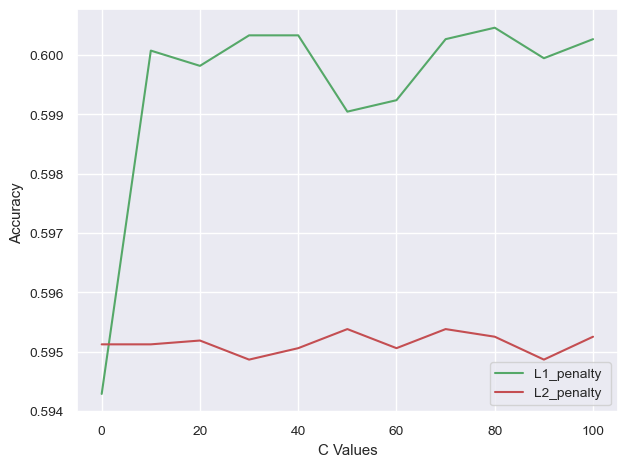

In [ ]:
grid_mean_score_lr = lr_gs.cv_results_['mean_test_Accuracy']
L1_score = grid_mean_score_lr[::2]
L2_score = grid_mean_score_lr[1::2]
lr_range = np.arange(0.01,101,10)

#Plot model accuracy for different C-values
plt.plot(lr_range,L1_score ,'g')
plt.plot(lr_range,L2_score ,'r')
plt.legend(('L1_penalty ', 'L2_penalty'))
plt.ylabel('Accuracy ')
plt.xlabel('C Values')
plt.grid(True)
plt.tight_layout()
plt.show()


#### Comment:

- As can be seen from the plot above, the L1 penalty performed better than the L2 penalty.
- The optimal regularization parameter is "C=60"

## Model Comparison

Next we comapre the performances of all the models considered in this project, to identify the best to be used for predicting the test data.

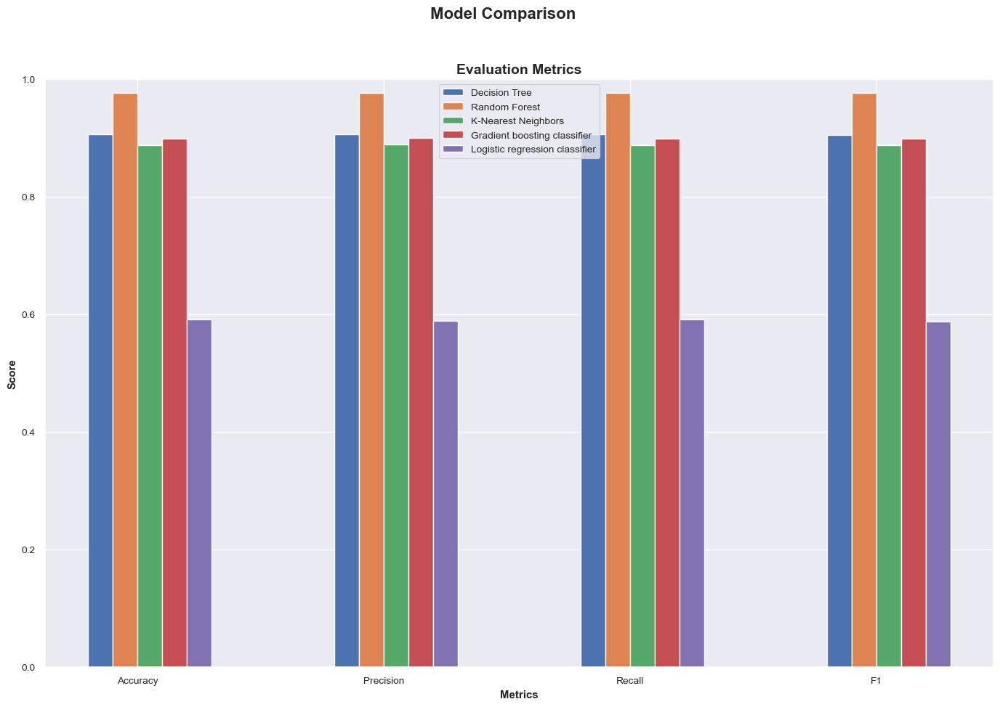

In [ ]:
# Intitialize figure with two plots
fig, (ax1) = plt.subplots(1, 1)
#fig, (ax1, ax2) = plt.subplots(1, 2)
fig.suptitle('Model Comparison', fontsize=16, fontweight='bold')
fig.set_figheight(10)
fig.set_figwidth(15)
fig.set_facecolor('white')

# First plot
## set bar size
barWidth = 0.1
dtc_score = [dtc_eval['acc'], dtc_eval['prec'], dtc_eval['rec'], dtc_eval['f1']]
rf_score = [rf_eval['acc'], rf_eval['prec'], rf_eval['rec'], rf_eval['f1']]
knn_score = [knn_eval['acc'], knn_eval['prec'], knn_eval['rec'], knn_eval['f1']]
gb_score = [gb_eval['acc'], gb_eval['prec'], gb_eval['rec'], gb_eval['f1']]
lr_score = [lr_eval['acc'], lr_eval['prec'], lr_eval['rec'], lr_eval['f1']]

## Set position of bar on X axis
r1 = np.arange(len(dtc_score))
r2 = [x + barWidth for x in r1]
r3 = [x + barWidth for x in r2]
r4 = [x + barWidth for x in r3]
r5 = [x + barWidth for x in r4]

## Make the plot
ax1.bar(r1, dtc_score, width=barWidth, edgecolor='white', label='Decision Tree')
ax1.bar(r2, rf_score, width=barWidth, edgecolor='white', label='Random Forest')
ax1.bar(r3, knn_score, width=barWidth, edgecolor='white', label='K-Nearest Neighbors')
ax1.bar(r4, gb_score, width=barWidth, edgecolor='white', label='Gradient boosting classifier')
ax1.bar(r5, lr_score, width=barWidth, edgecolor='white', label='Logistic regression classifier')


## Configure x and y axis
ax1.set_xlabel('Metrics', fontweight='bold')
labels = ['Accuracy', 'Precision', 'Recall', 'F1']
ax1.set_xticks([r + (barWidth * 1.5) for r in range(len(dtc_score))], )
ax1.set_xticklabels(labels)
ax1.set_ylabel('Score', fontweight='bold')
ax1.set_ylim(0, 1)

## Create legend & title
ax1.set_title('Evaluation Metrics', fontsize=14, fontweight='bold')
ax1.legend()



plt.show()

### Comment:

- As can be seen  from the barplot above, the performnace of the Random forest model is the best with regard to all the metrics (i.e Accuracy, Precision, Recall and F1-score) considered.
- The performances of the decision tree, gradient boosting and KNN is kinda the similar as their differences is not that much.
- Finally, the least performing model is the Logistic regression, which I think is due to the fact that it is primarily a binary classification algorithm.

In [ ]:
from sklearn.metrics import jaccard_score
from sklearn.metrics import f1_score
from sklearn.metrics import log_loss
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import accuracy_score

In [ ]:
# Obtaing the tuned parameters
start_time6 = datetime.now()

n_neigh = 1
depth = 19
#svm_choose = svm_ker[mean_svm.argmax()]
c = 60
pen = "l1"



#Setup the model with identified values
knn_model = KNeighborsClassifier(n_neighbors = n_neigh).fit(X_train, y_train)

#Calculate the values using identified Max Depth
dt_model = DecisionTreeClassifier(criterion = "entropy",max_depth = depth).fit(X_train, y_train)

#Model based on identified parameters
#svm_model = SVC(kernel = svm_choose, probability=True).fit(X_trainset,y_train)

#Model based on identified parameters
lr_model = LogisticRegression(penalty = pen,C = c, solver='liblinear').fit(X_train, y_train)

gb_model = gb.fit(X_train, y_train)

rf_model = rf.fit(X_train, y_train)

end_time6 = datetime.now()
print('Duration: {}'.format(end_time6 - start_time6))

Duration: 0:03:13.785569


In [ ]:
start_time7 = datetime.now()
results = []
names = []

algos = {
    "KNN": knn_model,
    "Decision Tree": dt_model,
    "Random Forest": rf_model,
    "Gradient Boosting": gb_model,
    "LogisticRegression": lr_model
}


for name, model in algos.items():
    yhatt = model.predict(X_test)
    test_results = accuracy_score(y_test, yhatt)
    results.append(test_results)
    names.append(name)

    jaccard_index = jaccard_score(y_test, yhatt, average='macro')
    f1_index = f1_score(y_test, yhatt,average ="weighted")
    log_loss_value = log_loss(y_test, model.predict_proba(X_test))
    print(name, '\n--------------------------------------------------\n',
          'Test Accuracy = ' ,test_results , '\t jaccard_index = ' , jaccard_index,  '\t log_loss = ' , log_loss_value)
    print (classification_report(y_test, yhatt))

end_time7 = datetime.now()
print('Duration: {}'.format(end_time7 - start_time7))

KNN 
--------------------------------------------------
 Test Accuracy =  0.9537156081254822 	 jaccard_index =  0.9089543299157986 	 log_loss =  1.6682585780511932
              precision    recall  f1-score   support

           0       0.97      0.98      0.97      1088
           1       0.95      0.92      0.93       789
           2       0.92      0.93      0.92       683
           3       0.94      0.97      0.96       646
           4       0.97      0.97      0.97       683

    accuracy                           0.95      3889
   macro avg       0.95      0.95      0.95      3889
weighted avg       0.95      0.95      0.95      3889

Decision Tree 
--------------------------------------------------
 Test Accuracy =  0.9195165852404217 	 jaccard_index =  0.8456661822820252 	 log_loss =  2.621202488377122
              precision    recall  f1-score   support

           0       0.95      0.96      0.95      1088
           1       0.90      0.89      0.90       789
           

In [ ]:
start_time8 = datetime.now()
#Use each model and predict the output
knn_yhat_t= knn_model.predict(X_test)
dt_yhat_t = dt_model.predict(X_test)
gb_yhat_t = gb_model.predict(X_test)
lr_yhat_t = lr_model.predict(X_test)
rf_yhat_t = rf_model.predict(X_test)

# Accuracy of models
knn_test = accuracy_score(y_test, knn_yhat_t)
dt_test = accuracy_score(y_test, dt_yhat_t)
gb_test = accuracy_score(y_test, gb_yhat_t)
lr_test = accuracy_score(y_test, lr_yhat_t)
rf_test = accuracy_score(y_test, rf_yhat_t)


#gb_model = gb.fit(x_train_SMOTE, y_train_SMOTE)

#rf_model = rf.fit(x_train_SMOTE, y_train_SMOTE)

#Calculate Jaccard index for each model
knn_JI = jaccard_score(y_test, knn_yhat_t,average='macro')
dt_JI = jaccard_score(y_test, dt_yhat_t,average='macro')
gb_JI = jaccard_score(y_test, gb_yhat_t,average='macro')
lr_JI = jaccard_score(y_test, lr_yhat_t,average='macro')
rf_JI = jaccard_score(y_test, rf_yhat_t,average='macro')

#Calculate F1 Score for each model
knn_F1 = f1_score(y_test, knn_yhat_t,average ="weighted")
dt_F1 = f1_score(y_test, dt_yhat_t,average ="weighted")
gb_F1 = f1_score(y_test, gb_yhat_t,average ="weighted")
lr_F1 = f1_score(y_test, lr_yhat_t,average ="weighted")
rf_F1 = f1_score(y_test, rf_yhat_t,average ="weighted")

#Calculate log loss for logistic regression model
probs_knn = knn_model.predict_proba(X_test)
probs_dt = dt_model.predict_proba(X_test)
probs_lr = lr_model.predict_proba(X_test)
probs_gb = gb_model.predict_proba(X_test)
probs_rf = rf_model.predict_proba(X_test)

knn_log = log_loss(y_test, probs_knn)
dt_log = log_loss(y_test, probs_dt)
lr_log = log_loss(y_test, probs_lr)
gb_log = log_loss(y_test, probs_gb)
rf_log = log_loss(y_test, probs_rf)

end_time8 = datetime.now()
print('Duration: {}'.format(end_time8 - start_time8))

Duration: 0:00:01.518130


In [ ]:
dtc_score = [dtc_eval['acc'], dtc_eval['prec'], dtc_eval['rec'], dtc_eval['f1']]
rf_score = [rf_eval['acc'], rf_eval['prec'], rf_eval['rec'], rf_eval['f1']]
knn_score = [knn_eval['acc'], knn_eval['prec'], knn_eval['rec'], knn_eval['f1']]
gb_score = [gb_eval['acc'], gb_eval['prec'], gb_eval['rec'], gb_eval['f1']]
lr_score = [lr_eval['acc'], lr_eval['prec'], lr_eval['rec'], lr_eval['f1']]

In [ ]:
#Initialize the Result dataframe
result_columns = ["Algorithm","Test Accuracy", "Jaccard","F1-Score","Log Loss", "Precision", "Recall"]
result_df = pd.DataFrame(columns=result_columns)

def build_result(Al,TA,JI,F1,LL, Precision, Recall):
    global result_df
    result_df = result_df.append({"Algorithm":Al,"Test Accuracy":"%.4f" %TA,"Jaccard":"%.4f" %JI,"F1-Score":"%.4f" %F1,"Log Loss":"%.4f" %LL,"Precision":"%.4f" %Precision,"Recall":"%.4f" %Recall},ignore_index=True)
    #result_df['Log Loss'] = result_df['Log Loss'].apply(lambda x: "NA" if (x=="NA") else "%.4f" %LL)

#Append each value to the result dataframe
build_result("KNN",knn_test,knn_JI,knn_F1,knn_log,knn_eval['prec'], knn_eval['rec'] )
build_result("Decision Tree",dt_test,dt_JI,dt_F1,dt_log, dtc_eval['prec'], dtc_eval['rec'])
build_result("Gradient Boosting",gb_test,gb_JI,gb_F1,gb_log, gb_eval['prec'], gb_eval['rec'])
build_result("Random Forest",rf_test,rf_JI,rf_F1,rf_log, rf_eval['prec'], rf_eval['rec'])
build_result("LogisticRegression",lr_test, lr_JI,lr_F1,lr_log, lr_eval['prec'], lr_eval['rec'])

#Initialize the Result dataframe
result_columns = ["Algorithm","Test Accuracy", "Jaccard","F1-Score","Log Loss", "Precision", "Recall"]
result_df = pd.DataFrame(columns=result_columns)

def build_result(Al,TA,JI,F1,LL, Precision, Recall):
    global result_df
    result_df = result_df.append({"Algorithm":Al,"Test Accuracy":"%.4f" %TA,"Jaccard":"%.4f" %JI,"F1-Score":"%.4f" %F1,"Log Loss":"%.4f" %LL,"Precision":"%.4f" %Precision,"Recall":"%.4f" %Recall},ignore_index=True)
    #result_df['Log Loss'] = result_df['Log Loss'].apply(lambda x: "NA" if (x=="NA") else "%.4f" %LL)

#Append each value to the result dataframe
build_result("KNN",knn_test,knn_JI,knn_F1,knn_log,knn_eval['prec'], knn_eval['rec'] )
build_result("Decision Tree",dt_test,dt_JI,dt_F1,dt_log, dtc_eval['prec'], dtc_eval['rec'])
build_result("Gradient Boosting",gb_test,gb_JI,gb_F1,gb_log, gb_eval['prec'], gb_eval['rec'])
build_result("Random Forest",rf_test,rf_JI,rf_F1,rf_log, rf_eval['prec'], rf_eval['rec'])
build_result("LogisticRegression",lr_test, lr_JI,lr_F1,lr_log, lr_eval['prec'], lr_eval['rec'])

print("Comparative Analysis for Original Unbalanced Data")
result_df

Comparative Analysis for Original Unbalanced Data


,Algorithm,Test Accuracy,Jaccard,F1-Score,Log Loss,Precision,Recall
0,KNN,0.9537,0.9090,0.9536,1.6683,0.8896,0.8876
1,Decision Tree,0.9195,0.8457,0.9194,2.6212,0.9060,0.9059
2,Gradient Boosting,0.8984,0.8092,0.8984,0.3843,0.9008,0.8987
3,Random Forest,0.9766,0.9521,0.9766,0.1822,0.9768,0.9766
4,LogisticRegression,0.6122,0.4300,0.6086,1.0146,0.5894,0.5914


### Comment:
- From the table above, it is very evident that, the Random Forest excels on all metrics with regard to the original data.
- As has been previously stated, the logistic regression is the worst performing model as it performed very poorly on all metrics for the data set.
- When we using Test Accuracy, Jaccard and F1-Score as a metrics, the KNN is the 2nd best performing model, followed by Decision Tree ad Gradient Boosting
- With regard to the log_loss, Gradient boosting is the 2nd best performing model, followed by KNN and then Decision tree
- In terms of the precion and recall, Decision Tree was the 2nd best model, while Gradient boosting outperformed KNN.

In [ ]:
# Obtaing the tuned parameters
start_time6 = datetime.now()

n_neigh = 1
depth = 19
#svm_choose = svm_ker[mean_svm.argmax()]
c = 10
pen = "l2"



#Setup the model with identified values
knn_sm_model = KNeighborsClassifier(n_neighbors = n_neigh).fit(X_train_sm, y_train_sm)

#Calculate the values using identified Max Depth
dt_sm_model = DecisionTreeClassifier(criterion = "entropy",max_depth = depth).fit(X_train_sm, y_train_sm)

#Model based on identified parameters
lr_sm_model = LogisticRegression(penalty = pen,C = c, solver='liblinear').fit(X_train_sm, y_train_sm)

gb_sm_model = gb.fit(X_train_sm, y_train_sm)

rf_sm_model = rf.fit(X_train_sm, y_train_sm)

end_time6 = datetime.now()
print('Duration: {}'.format(end_time6 - start_time6))

Duration: 0:02:38.319070


In [ ]:
start_time7 = datetime.now()
results = []
names = []

algos = {
    "KNN": knn_sm_model,
    "Decision Tree": dt_sm_model,
    "Random Forest": rf_model,
    "Gradient Boosting": gb_sm_model,
    "LogisticRegression": lr_sm_model
}


for name, model in algos.items():
    yhatt = model.predict(X_test_sm)
    test_results = accuracy_score(y_test_sm, yhatt)
    results.append(test_results)
    names.append(name)

    jaccard_index = jaccard_score(y_test_sm, yhatt, average='macro')
    f1_index = f1_score(y_test_sm, yhatt,average ="weighted")
    log_loss_value = log_loss(y_test_sm, model.predict_proba(X_test_sm))
    print(name, '\n--------------------------------------------------\n',
          'Test Accuracy = ' ,test_results , '\t jaccard_index = ' , jaccard_index,  '\t log_loss = ' , log_loss_value)
    print (classification_report(y_test_sm, yhatt))

end_time7 = datetime.now()
print('Duration: {}'.format(end_time7 - start_time7))

KNN 
--------------------------------------------------
 Test Accuracy =  0.9804772234273319 	 jaccard_index =  0.9619029734185178 	 log_loss =  0.7036721919784268
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      1101
           1       0.98      0.98      0.98      1114
           2       0.97      0.98      0.98      1150
           3       0.98      0.99      0.98      1100
           4       0.99      0.98      0.99      1067

    accuracy                           0.98      5532
   macro avg       0.98      0.98      0.98      5532
weighted avg       0.98      0.98      0.98      5532

Decision Tree 
--------------------------------------------------
 Test Accuracy =  0.9446854663774403 	 jaccard_index =  0.8954082260344419 	 log_loss =  1.8771200103227037
              precision    recall  f1-score   support

           0       0.95      0.95      0.95      1101
           1       0.94      0.93      0.93      1114
          

In [ ]:
start_time8 = datetime.now()
#Use each model and predict the output
knn_yhat_t= knn_sm_model.predict(X_test_sm)
dt_yhat_t = dt_sm_model.predict(X_test_sm)
gb_yhat_t = gb_sm_model.predict(X_test_sm)
lr_yhat_t = lr_sm_model.predict(X_test_sm)
rf_yhat_t = rf_sm_model.predict(X_test_sm)

# Accuracy of models
knn_test_sm = accuracy_score(y_test_sm, knn_yhat_t)
dt_test_sm = accuracy_score(y_test_sm, dt_yhat_t)
gb_test_sm = accuracy_score(y_test_sm, gb_yhat_t)
lr_test_sm = accuracy_score(y_test_sm, lr_yhat_t)
rf_test_sm = accuracy_score(y_test_sm, rf_yhat_t)


#gb_model = gb.fit(x_train_SMOTE, y_train_SMOTE)

#rf_model = rf.fit(x_train_SMOTE, y_train_SMOTE)

#Calculate Jaccard index for each model
knn_JI_sm = jaccard_score(y_test_sm, knn_yhat_t,average='macro')
dt_JI_sm = jaccard_score(y_test_sm, dt_yhat_t,average='macro')
gb_JI_sm = jaccard_score(y_test_sm, gb_yhat_t,average='macro')
lr_JI_sm = jaccard_score(y_test_sm, lr_yhat_t,average='macro')
rf_JI_sm = jaccard_score(y_test_sm, rf_yhat_t,average='macro')

#Calculate F1 Score for each model
knn_F1_sm = f1_score(y_test_sm, knn_yhat_t,average ="weighted")
dt_F1_sm = f1_score(y_test_sm, dt_yhat_t,average ="weighted")
gb_F1_sm = f1_score(y_test_sm, gb_yhat_t,average ="weighted")
lr_F1_sm = f1_score(y_test_sm, lr_yhat_t,average ="weighted")
rf_F1_sm = f1_score(y_test_sm, rf_yhat_t,average ="weighted")

#Calculate log loss for logistic regression model
probs_knn_sm = knn_model.predict_proba(X_test_sm)
probs_dt_sm = dt_model.predict_proba(X_test_sm)
probs_lr_sm = lr_model.predict_proba(X_test_sm)
probs_gb_sm = gb_model.predict_proba(X_test_sm)
probs_rf_sm = rf_model.predict_proba(X_test_sm)

knn_log_sm = log_loss(y_test_sm, probs_knn_sm)
dt_log_sm = log_loss(y_test_sm, probs_dt_sm)
lr_log_sm = log_loss(y_test_sm, probs_lr_sm)
gb_log_sm = log_loss(y_test_sm, probs_gb_sm)
rf_log_sm = log_loss(y_test_sm, probs_rf_sm)

end_time8 = datetime.now()
print('Duration: {}'.format(end_time8 - start_time8))

Duration: 0:00:02.131917


In [ ]:
dtc_score_sm = [dtc_sm_eval['acc'], dtc_sm_eval['prec'], dtc_sm_eval['rec'], dtc_sm_eval['f1']]
rf_score_sm = [rf_sm_eval['acc'], rf_sm_eval['prec'], rf_sm_eval['rec'], rf_sm_eval['f1']]
knn_score_sm = [knn_sm_eval['acc'], knn_sm_eval['prec'], knn_sm_eval['rec'], knn_sm_eval['f1']]
gb_score_sm = [gb_sm_eval['acc'], gb_sm_eval['prec'], gb_sm_eval['rec'], gb_sm_eval['f1']]
lr_score_sm = [lr_sm_eval['acc'], lr_sm_eval['prec'], lr_sm_eval['rec'], lr_sm_eval['f1']]

In [ ]:
#Initialize the Result dataframe
result_columns = ["Algorithm","Test Accuracy", "Jaccard","F1-Score","Log Loss", "Precision", "Recall"]
result_df = pd.DataFrame(columns=result_columns)

def build_result(Al,TA,JI,F1,LL, Precision, Recall):
    global result_df
    result_df = result_df.append({"Algorithm":Al,"Test Accuracy":"%.4f" %TA,"Jaccard":"%.4f" %JI,"F1-Score":"%.4f" %F1,"Log Loss":"%.4f" %LL,"Precision":"%.4f" %Precision,"Recall":"%.4f" %Recall},ignore_index=True)
    #result_df['Log Loss'] = result_df['Log Loss'].apply(lambda x: "NA" if (x=="NA") else "%.4f" %LL)

#Append each value to the result dataframe
print("Comparative Analysis for Balanced Data")
build_result("KNN",knn_test_sm,knn_JI_sm,knn_F1_sm,knn_log_sm,knn_sm_eval['prec'], knn_sm_eval['rec'] )
build_result("Decision Tree",dt_test_sm,dt_JI_sm,dt_F1_sm,dt_log_sm, dtc_sm_eval['prec'], dtc_sm_eval['rec'])
build_result("Gradient Boosting",gb_test_sm,gb_JI_sm,gb_F1_sm,gb_log_sm, gb_sm_eval['prec'], gb_sm_eval['rec'])
build_result("Random Forest",rf_test_sm,rf_JI_sm,rf_F1_sm,rf_log_sm, rf_sm_eval['prec'], rf_sm_eval['rec'])
build_result("LogisticRegression",lr_test_sm, lr_JI_sm,lr_F1_sm,lr_log_sm, lr_sm_eval['prec'], lr_sm_eval['rec'])

result_df

Comparative Analysis for Balanced Data


,Algorithm,Test Accuracy,Jaccard,F1-Score,Log Loss,Precision,Recall
0,KNN,0.9805,0.9619,0.9805,0.4887,0.8337,0.8272
1,Decision Tree,0.9447,0.8954,0.9447,1.1015,0.9649,0.9649
2,Gradient Boosting,0.9056,0.8291,0.9059,0.3670,0.9121,0.9094
3,Random Forest,0.9910,0.9822,0.9910,0.1280,0.9923,0.9922
4,LogisticRegression,0.5962,0.4243,0.5940,1.0489,0.5756,0.5719


### Comment:

Similar results on the performance of the models is obtained when the balanced data is used.

**Comment**

Since random forest provides us the maximum recall score with the lowest false negative value in the confusion matrix, adopting RECALL as the final metric may work, in my opinion.

### Model Optimisation-
Let us optimise our naive bayes model by tuning the hyper parameters available from the scikit-learn library. After finding the optimal parameters we will then evaluate our new model by comparing it against our base line model.

#### Parameter tuning
We'll tune the RF using a random search grid. We could use a grid search but it is computationally expensive and given that we're
On >99% accuracy and only need to predict a data set size of 20, I think we can manage without.

In [ ]:
start_time2 = datetime.now()

from sklearn.model_selection import GridSearchCV

# gridsearch searches for the best hyperparameters and keeps the classifier with the highest recall score

# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 10, stop = 50, num = 10)]

# Number of features to consider at every split
max_features = ['auto', 'sqrt']

# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 1000, num = 10)]
max_depth.append(None)

# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]

# Minimum number of samples required at each leaf node
min_samples_leaf = [2, 4, 10, 100]

# Method of selecting samples for training each tree
bootstrap = [True, False]

# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
print(random_grid)

end_time2 = datetime.now()
print('Duration: {}'.format(end_time2 - start_time2))

{'n_estimators': [10, 14, 18, 23, 27, 32, 36, 41, 45, 50], 'max_features': ['auto', 'sqrt'], 'max_depth': [10, 120, 230, 340, 450, 560, 670, 780, 890, 1000, None], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [2, 4, 10, 100], 'bootstrap': [True, False]}
Duration: 0:00:00.001000


Using the random grid to search for best hyperparameters.  Random search of parameters, using 5 fold cross validation,
Search across 100 different combinations, and use all available cores

In [ ]:
start_time2 = datetime.now()
rf_random = RandomizedSearchCV(estimator = rf,
                               param_distributions = random_grid,
                               n_iter = 100, cv = 5, verbose=2,
                               random_state=42, n_jobs = -1)
# Fit the random search model
rf_random.fit(X_train, y_train)

end_time2 = datetime.now()
print('Duration: {}'.format(end_time2 - start_time2))

Fitting 5 folds for each of 100 candidates, totalling 500 fits
Duration: 0:04:48.495771


In [ ]:
print(rf_random.best_params_)

{'n_estimators': 36, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': 'auto', 'max_depth': 780, 'bootstrap': False}


#### Evaluating Optimised Model

We can use the bestestimator attribute of the GridSearchCV object to save our optimized model into a variable called best grid after determining the best parameter for the model. On the following step, we will compute the evaluation metrics and compare them to our base model.

In [ ]:
# Select best model with best fit
best_grid = rf_random.best_estimator_

# Evaluate Model
best_grid_eval = evaluate_model(best_grid, X_test, y_test)

# Print result
print('Accuracy:', best_grid_eval['acc'])
print('Precision:', best_grid_eval['prec'])
print('Recall:', best_grid_eval['rec'])
print('F1 Score:', best_grid_eval['f1'])
#print('Area Under Curve:', best_grid_eval['auc'])
print('Confusion Matrix:\n', best_grid_eval['cm'])

Accuracy: 0.9802005656981229
Precision: 0.9802892073399534
Recall: 0.9802005656981229
F1 Score: 0.9801915218193165
Confusion Matrix:
 [[1085    2    0    0    1]
 [  13  764    8    0    4]
 [   3   13  665    2    0]
 [   0    0   21  623    2]
 [   0    2    1    5  675]]


#### Model Comparison

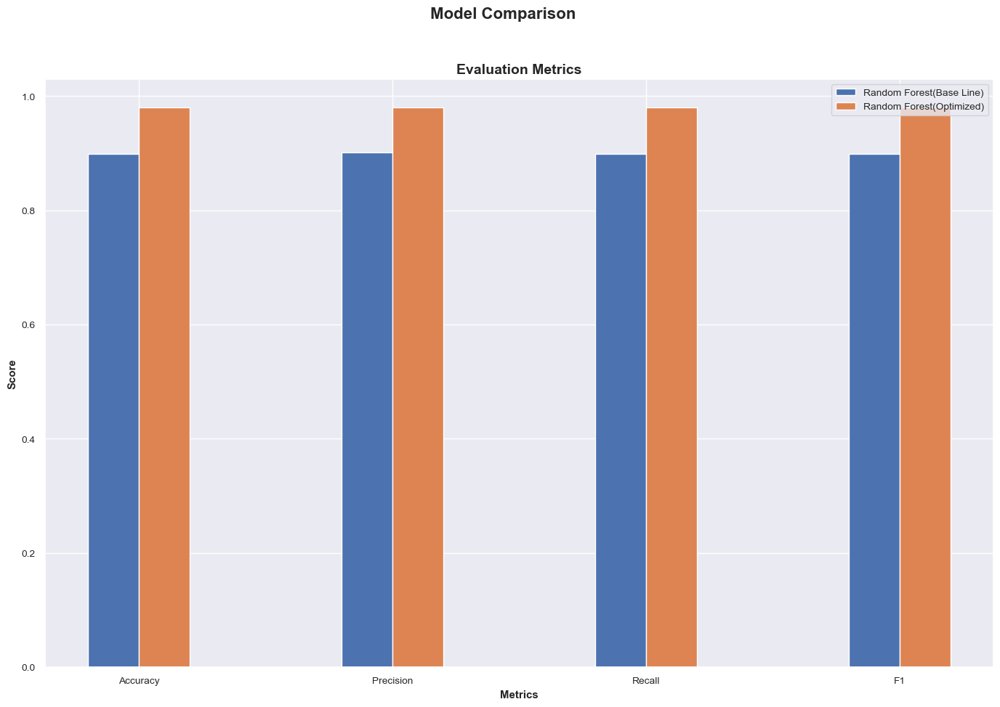

Change of 0.37% on accuracy.
Change of 0.35% on precision.
Change of 0.37% on recall.
Change of 0.37% on F1 score.


In [ ]:
# Intitialize figure with two plots
fig, (ax1) = plt.subplots(1)
fig.suptitle('Model Comparison', fontsize=16, fontweight='bold')
fig.set_figheight(10)
fig.set_figwidth(15)
fig.set_facecolor('white')

# First plot
## set bar size
barWidth = 0.2
rf_score = [rf_eval['acc'], rf_eval['prec'], rf_eval['rec'], rf_eval['f1']]
best_grid_score = [best_grid_eval['acc'], best_grid_eval['prec'], best_grid_eval['rec'], best_grid_eval['f1']]

## Set position of bar on X axis
r1 = np.arange(len(gb_score))
r2 = [x + barWidth for x in r1]

## Make the plot
ax1.bar(r1, gb_score, width=barWidth, edgecolor='white', label='Random Forest(Base Line)')
ax1.bar(r2, best_grid_score, width=barWidth, edgecolor='white', label='Random Forest(Optimized)')

## Add xticks on the middle of the group bars
ax1.set_xlabel('Metrics', fontweight='bold')
labels = ['Accuracy', 'Precision', 'Recall', 'F1']
ax1.set_xticks([r + (barWidth * 0.5) for r in range(len(dtc_score))], )
ax1.set_xticklabels(labels)
ax1.set_ylabel('Score', fontweight='bold')

## Create legend & Show graphic
ax1.set_title('Evaluation Metrics', fontsize=14, fontweight='bold')
ax1.legend()



plt.show()

print('Change of {:0.2f}% on accuracy.'.format(100 * ((best_grid_eval['acc'] - rf_eval['acc']) / rf_eval['acc'])))
print('Change of {:0.2f}% on precision.'.format(100 * ((best_grid_eval['prec'] - rf_eval['prec']) / rf_eval['prec'])))
print('Change of {:0.2f}% on recall.'.format(100 * ((best_grid_eval['rec'] - rf_eval['rec']) / rf_eval['rec'])))
print('Change of {:0.2f}% on F1 score.'.format(100 * ((best_grid_eval['f1'] - rf_eval['f1']) / rf_eval['f1'])))
#print('Change of {:0.2f}% on AUC.'.format(100 * ((best_grid_eval['auc'] - gb_eval['auc']) / gb_eval['auc'])))


#rf_score = [rf_eval['acc'], rf_eval['prec'], rf_eval['rec'], rf_eval['f1']]

### Comment:

- It can be seen that the optimised random forest model where the parameters have been hypertuned out-performs the base random forest model.
- It particular it is observed that:
 - There is a 0.37% increase in the performance with regards to accuracy, recall and the F1-score.
 - Finally, there is a 0.35% increment in the precision when the optimised model is used compare to the base model.


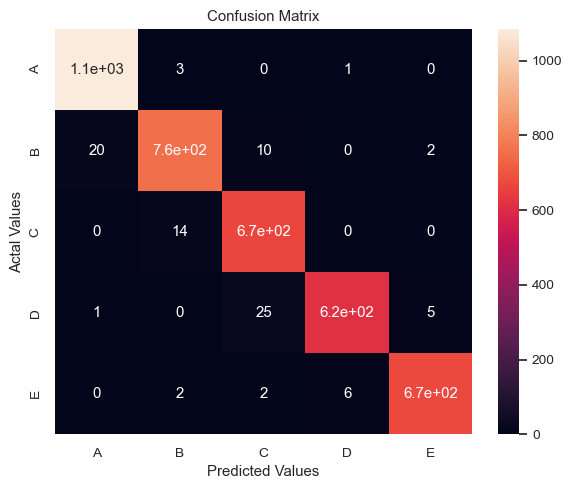

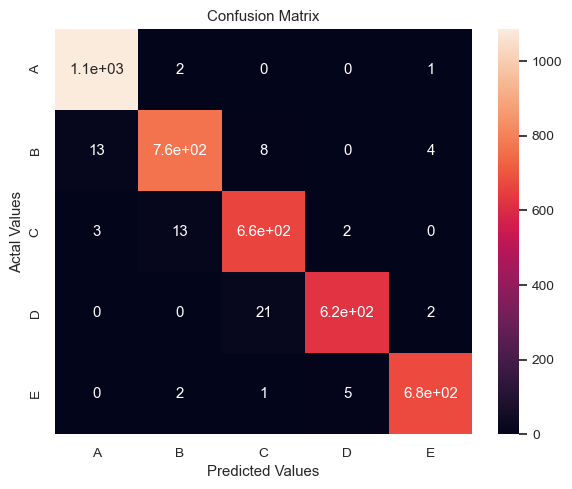

In [ ]:
cm_rf = pd.DataFrame(rf_eval['cm'],
                     index = ['A','B','C', 'D', 'E'],
                     columns = ['A','B','C', 'D', 'E'])

#Plotting the confusion matrix
plt.figure(figsize=(6,5))
sns.heatmap(cm_rf, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

cm_rfb = pd.DataFrame(best_grid_eval['cm'],
                     index = ['A','B','C', 'D', 'E'],
                     columns = ['A','B','C', 'D', 'E'])

#Plotting the confusion matrix
plt.figure(figsize=(6,5))
sns.heatmap(cm_rfb, annot=True)
plt.title('Confusion Matrix')
plt.ylabel('Actal Values')
plt.xlabel('Predicted Values')
plt.show()

#### Comment:
From the two confusion matrices above, it can be observed that:
The based model misclassified:
- 4 (3 class B and 1 class D) as class A
- 32 (20 class A, 10 class C and 2 class E) as class B
- 14 class B as class C
- 31 (1 class A, 25 class C and 5 class E) as class D
- 10 (2 class B, 2 class C and 6 class D) as class E

Similarly, for the optimized model, the following were wrongly classified:
- 3 (2 class B and 1 class E) as class A
- 25 (13 class A, 8 class C and 4 class E) as class B
- 18 (3 class A, 13 class B and 2 class D) as class C
- 23 (21 class C and 2 class E) as class D
- Finally, 8 (2 class B, 1 class C and 5 class D) as class E

# Final Predictions

**Finally, we used the best parameters of the hypertuned model, to predict the classes of the test data.**

In [ ]:
best_params_rf = rf_random.best_estimator_
best_params_rf.fit(X_test, y_test)

RandomForestClassifier(bootstrap=False, max_depth=780, max_features='auto',
                       min_samples_leaf=2, n_estimators=36, random_state=7)

In [ ]:
y_pred_rf = best_params_rf.predict(X_test)

In [ ]:
obs = list(range(1,181))

In [ ]:
final_predictions = best_params_rf.predict(test_df_11)

In [ ]:
pd.DataFrame(final_predictions).to_csv('final_predictions.csv', index=None, header  = ["yhat"])

In [ ]:
final_predictions

array([1, 4, 4, 4, 3, 1, 4, 0, 4, 0, 1, 4, 4, 1, 0, 0, 3, 0, 0, 1, 1, 2,
       2, 1, 0, 0, 3, 2, 1, 2, 1, 1, 4, 2, 3, 1, 0, 0, 0, 2, 0, 0, 0, 2,
       0, 4, 2, 2, 3, 3, 1, 1, 4, 0, 0, 3, 0, 2, 2, 2, 3, 1, 0, 3, 4, 0,
       4, 0, 1, 0, 2, 1, 2, 4, 2, 3, 4, 4, 1, 2, 3, 3, 1, 4, 3, 4, 1, 2,
       0, 0, 2, 2, 2, 4, 4, 2, 0, 3, 2, 0, 4, 2, 0, 1, 1, 0, 2, 4, 2, 2,
       0, 3, 4, 0, 3, 1, 0, 1, 3, 0, 3, 3, 1, 0, 2, 4, 2, 2, 4, 4, 1, 0,
       3, 0, 0, 0, 0, 0, 3, 4, 0, 2, 1, 1, 2, 0, 2, 3, 1, 3, 0, 4, 2, 4,
       4, 4, 0, 0, 0, 0, 0, 0, 1, 2, 2, 2, 3, 2, 0, 4, 2, 2, 0, 0, 2, 4,
       4, 3, 2, 1], dtype=int64)

### Changing the predictions from "0, 1, 2, 3 and 4" back to the original classes "A", "B", "C", "D" and "E"

In [ ]:
final_df = pd.read_csv("final_predictions.csv")
final_df.head()


from sklearn import preprocessing

le = preprocessing.LabelEncoder()
le.fit(['A', 'B', 'C', 'D', 'E'])

print(le.classes_)

le.transform(['A', 'B', 'C', 'D', 'E'])

final_predictions = le.inverse_transform(final_df['yhat'])
pd.DataFrame(final_predictions).to_csv('final_predictions_1.csv', index=None, header  = ["yhat"])




['A' 'B' 'C' 'D' 'E']


In [ ]:
le.inverse_transform(final_df['yhat'])

array(['B', 'E', 'E', 'E', 'D', 'B', 'E', 'A', 'E', 'A', 'B', 'E', 'E',
       'B', 'A', 'A', 'D', 'A', 'A', 'B', 'B', 'C', 'C', 'B', 'A', 'A',
       'D', 'C', 'B', 'C', 'B', 'B', 'E', 'C', 'D', 'B', 'A', 'A', 'A',
       'C', 'A', 'A', 'A', 'C', 'A', 'E', 'C', 'C', 'D', 'D', 'B', 'B',
       'E', 'A', 'A', 'D', 'A', 'C', 'C', 'C', 'D', 'B', 'A', 'D', 'E',
       'A', 'E', 'A', 'B', 'A', 'C', 'B', 'C', 'E', 'C', 'D', 'E', 'E',
       'B', 'C', 'D', 'D', 'B', 'E', 'D', 'E', 'B', 'C', 'A', 'A', 'C',
       'C', 'C', 'E', 'E', 'C', 'A', 'D', 'C', 'A', 'E', 'C', 'A', 'B',
       'B', 'A', 'C', 'E', 'C', 'C', 'A', 'D', 'E', 'A', 'D', 'B', 'A',
       'B', 'D', 'A', 'D', 'D', 'B', 'A', 'C', 'E', 'C', 'C', 'E', 'E',
       'B', 'A', 'D', 'A', 'A', 'A', 'A', 'A', 'D', 'E', 'A', 'C', 'B',
       'B', 'C', 'A', 'C', 'D', 'B', 'D', 'A', 'E', 'C', 'E', 'E', 'E',
       'A', 'A', 'A', 'A', 'A', 'A', 'B', 'C', 'C', 'C', 'D', 'C', 'A',
       'E', 'C', 'C', 'A', 'A', 'C', 'E', 'E', 'D', 'C', 'B'], d

In [ ]:
final_predictions

array(['B', 'E', 'E', 'E', 'D', 'B', 'E', 'A', 'E', 'A', 'B', 'E', 'E',
       'B', 'A', 'A', 'D', 'A', 'A', 'B', 'B', 'C', 'C', 'B', 'A', 'A',
       'D', 'C', 'B', 'C', 'B', 'B', 'E', 'C', 'D', 'B', 'A', 'A', 'A',
       'C', 'A', 'A', 'A', 'C', 'A', 'E', 'C', 'C', 'D', 'D', 'B', 'B',
       'E', 'A', 'A', 'D', 'A', 'C', 'C', 'C', 'D', 'B', 'A', 'D', 'E',
       'A', 'E', 'A', 'B', 'A', 'C', 'B', 'C', 'E', 'C', 'D', 'E', 'E',
       'B', 'C', 'D', 'D', 'B', 'E', 'D', 'E', 'B', 'C', 'A', 'A', 'C',
       'C', 'C', 'E', 'E', 'C', 'A', 'D', 'C', 'A', 'E', 'C', 'A', 'B',
       'B', 'A', 'C', 'E', 'C', 'C', 'A', 'D', 'E', 'A', 'D', 'B', 'A',
       'B', 'D', 'A', 'D', 'D', 'B', 'A', 'C', 'E', 'C', 'C', 'E', 'E',
       'B', 'A', 'D', 'A', 'A', 'A', 'A', 'A', 'D', 'E', 'A', 'C', 'B',
       'B', 'C', 'A', 'C', 'D', 'B', 'D', 'A', 'E', 'C', 'E', 'E', 'E',
       'A', 'A', 'A', 'A', 'A', 'A', 'B', 'C', 'C', 'C', 'D', 'C', 'A',
       'E', 'C', 'C', 'A', 'A', 'C', 'E', 'E', 'D', 'C', 'B'], d

## Importance Variables

In order to identify and highlight the most important variables that contributed highly in predicting the outcomes, the random forest feature importance is used:

<Axes: >

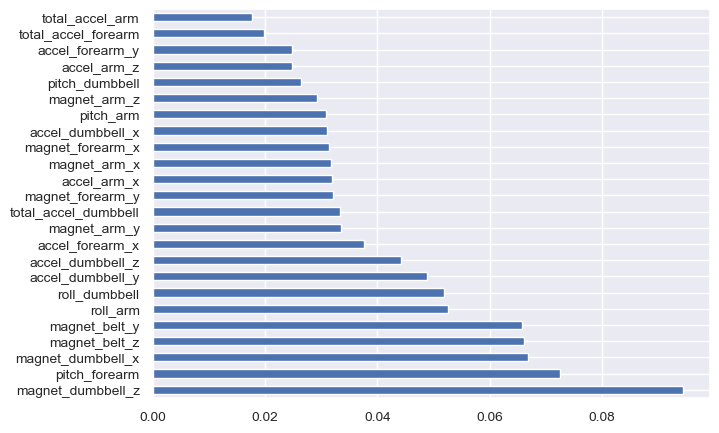

In [ ]:
rf_final = RandomForestClassifier(n_estimators=500, random_state = 42)
rf_final.fit(X_train, y_train);
feat_importances = pd.Series(rf_final.feature_importances_, index=X_train.columns)
feat_importances.nlargest(25).plot(kind='barh')

### Comment:

From the graph output above, it can be observed that:
- More than 8% of the predictive power is attributed to "magnet_dumbell_z" variable
- More than 6% of the predictive power of the model is contributed each by:
    - "pitch_forearm",
    - "magnet_dumbell_x",
    - "magnet_bell_x" and
    - "magnet_bell_y"
- More than 4% of the prediction power is contributed each by these four variables;
    - "roll_arm",
    - "roll_dumbell",
    - "accel_dumbell_y" and
    - "accel_dumbell_z"
    
- These 9 variables listed above jointly contribute to approximately 50% of the predictive power of the random forest model.

# Executive Summary:

- Preliminary data analysis reveals that the training dataset has 19442 observations for 160 variables. The variable classe, a factor variable with 5 levels **A, B, C, D and E**, in the last column, indicates the solution to the provided classification problem. There seem to be a class inbalance in the training set.
- Except for the final column containing the outcome classe in the training dataset and absent in the test dataset, both datasets have consistent variable names but have a substantial number of missing values.
- The variables with more than 80% missing values were dropped.
- In the dataset it was observed that most the variables were highly linearly correlated both negatively and positively.
- Running a PCA on the train data, it was observed that, 95% of the variability in the data can be explained by only 24 variables, and 35 variables were enough to capture 99% variablility in the data.
- With this in mid, the **SelectKBest** procedure was was to select the best 24 variables to be used in the reduced model
- Due to the seemingly, class inbalance, another dataframe was generated using the SMOTE package to get equal classes.
- Modeling and analyses were performed in the two data sets explained from aabove.
- Five (5) different classification algorithms was used in this project:
    - Decision trees
    - KNN
    - Random Forest
    - Gradient Boosting
    - Logistic Regression (although primarily used for binary classification, it can be extended to handle multi class classification through techniques such as One-vs-Rest or One-vs-One)
- Comparing the perormance of the models considered, it was observed even a relatively simple Random Forest model appeared to be very effective at predicting the classe of the repetitions with 97.66% accuracy.
- Also, increasing the number of repeats and folds in the random forest showed some improvement but dramatically increased the processing time.
- Also, removing the highly correlated variables from the data did not have a significant impact on the model accuracy in this case.





## Insights found

- In this project, it was observed that: the model performance increased significantly in the following models
    - Decision Tree
    - Random Forest
    - Gradient Boosting
- when the balanced data was used instead of the original unbalanced data.
- But interestingly the model accuracy decreased for KNN and Logistic Regression when the balanced data was used for the training as compared to the original data
- From the results above, it is very evident that, the Random Forest excels on all metrics with regard to the original data.
- As has been previously stated, the logistic regression is the worst performing model as it performed very poorly on all metrics for the data set.
- When we using Test Accuracy, Jaccard and F1-Score as a metrics, the KNN is the 2nd best performing model, followed by Decision Tree ad Gradient Boosting
- With regard to the log_loss, Gradient boosting is the 2nd best performing model, followed by KNN and then Decision tree
- In terms of the precion and recall, Decision Tree was the 2nd best model, while Gradient boosting outperformed KNN.
- The random forest feature importance was used to identify and highlight the most important variables that contributed highly in predicting the outcomes.It was observed that:
    - More than 8% of the predictive power is attributed to "magnet_dumbell_z" variable
    - More than 6% of the predictive power of the model is contributed each by:
        - "pitch_forearm",
        - "magnet_dumbell_x",
        - "magnet_bell_x" and
        - "magnet_bell_y"
    - More than 4% of the prediction power is contributed each by these four variables;
        - "roll_arm",
        - "roll_dumbell",
        - "accel_dumbell_y" and
        - "accel_dumbell_z"
    
    - These 9 variables listed above jointly contribute to approximately 50% of the predictive power of the random forest model.

**NOTE -**
- For a simple model, it is clear that our model did a decent job of classifying the data.  
- Even when the model has been optimized, the outcome is not much different.
- We can attempt to investigate other methods (such as SVM, Neural Networks,Gaussian Naive Bayes, Linear and Quadratic Discriminant Analysis, etc), instead of athe KNN and Logistic Regression in an effort to enhance our results.
- We could also explore other model explanability tecniques, such as LIME (Local Interpretable Model-Agnostic Explanations), SHAP (SHapley Additive exPlanations)  and PDP (Partial Dependency Plot) to better understand the contributions of the varibales in the model